In [2]:
import librosa
import librosa.display
import matplotlib.pyplot as plt
import os
import numpy as np

os.listdir('../demucs_separated/mdx_extra/ПОШЛАЯ МОЛЛИ - Контракт')

['other.mp3', 'bass.mp3', 'drums.mp3', 'vocals.mp3']

## BASIC-PITCH

Experiments with basic-pitch predicting on my songs. Visualization of PrettyMIDI file, Contour, Note, Note_events, + whisper transcribation

#### Preparing (4)

In [16]:
!pip3 install matplotlib numpy basic-pitch -q

In [17]:
os.listdir(vocal_tracks_folder)

['Heartbeat - Childish Gambino',
 'Lucid WRLD - Yang_d Out (prod. Drew Banga)',
 'Пошлая Молли, Элджей - Дом Периньон',
 'Marshmello-feat-Omar-Linx_-_Keep-It-Mello',
 'Ed Sheeran - Shape Of You',
 'Justin Bieber - What Do You Mean',
 'alan-walker-fade',
 'Martin Garrix — Animals',
 'the_chainsmokers_feat_halsey_-_closer_(zf.fm)',
 'АДЛИН, Килджо - Одна (MP3SUN.net)',
 'apologize',
 'pascal_letoublon_friendships',
 'Адлин - Dead inside (Muzten.net)',
 'mxnarch - Nightwing',
 'Coldplay — The Scientist',
 'DEAD BLONDE - Мальчик на девятке',
 'ПОШЛАЯ МОЛЛИ - Контракт',
 'Marshmello - Ritual ft Wrabel (Official Music Vide',
 'Alan Walker - Faded']

In [4]:
from basic_pitch.inference import predict
from basic_pitch import ICASSP_2022_MODEL_PATH

# model_output, midi_data, note_events = predict(<input-audio-path>)

/Library/Python/3.8/site-packages/urllib3/__init__.py:35: NotOpenSSLWarning: urllib3 v2 only supports OpenSSL 1.1.1+, currently the 'ssl' module is compiled with 'LibreSSL 2.8.3'. See: https://github.com/urllib3/urllib3/issues/3020
  warnings.warn(


In [8]:
vocal_tracks_folder = '../demucs_separated/mdx_extra/'
for subdir in os.listdir(vocal_tracks_folder)[2:3]:
    audio_path = os.path.join(vocal_tracks_folder, subdir, 'vocals.mp3')
    model_output, midi_data, note_events = predict(audio_path)

Predicting MIDI for ../demucs_separated/mdx_extra/Пошлая Молли, Элджей - Дом Периньон/vocals.mp3...


In [192]:
def get_predicted(track_paths):
    result = {}
    for audio_path in track_paths:
        model_output, midi_data, note_events = predict(audio_path)
        result[audio_path] = model_output, midi_data, note_events
    return result

In [19]:
for key, val in model_output.items():
    print(key, val.shape)

contour (15042, 264)
note (15042, 88)
onset (15042, 88)


In [28]:
midi_data

### Visualization of PrettyMIDI

In [130]:
import pretty_midi
import numpy as np
import matplotlib.pyplot as plt

def plot_piano_roll(midi_data, start_pitch=21, end_pitch=108, fs=100, L_time=0, R_time=None, name=""):
    """
    Plot a piano roll diagram of MIDI data for a specific time range.

    Parameters:
    - midi_data: PrettyMIDI object
    - start_pitch: The MIDI note number of the lowest pitch to include in the piano roll
    - end_pitch: The MIDI note number of the highest pitch to include in the piano roll
    - fs: Sampling frequency of the columns; i.e., each column is spaced apart by 1./fs seconds
    - L_time: Start time for the piano roll slice in seconds
    - R_time: End time for the piano roll slice in seconds; if None, use the end time of the MIDI data
    """
    # Ensure R_time is not beyond the end of the MIDI data
    if R_time is None or R_time > midi_data.get_end_time():
        R_time = midi_data.get_end_time()
    
    # Extract piano roll from the MIDI data
    piano_roll = midi_data.get_piano_roll(fs=fs)[start_pitch:end_pitch, :]
    
    # Calculate time array for x-axis
    times = np.linspace(0, midi_data.get_end_time(), piano_roll.shape[1])
    # Find indices for the specified time range
    time_slice = np.where((times >= L_time) & (times <= R_time))[0]
    
    fig, ax = plt.subplots(figsize=(24, 6))
    ax.imshow(piano_roll[:, time_slice], aspect='auto', origin='lower', cmap='magma',
              extent=[times[time_slice].min(), times[time_slice].max(), start_pitch, end_pitch])
    
    # Set the ticks to be note names, one per octave
    note_ticks = range(start_pitch, end_pitch, 3)
    note_labels = [pretty_midi.note_number_to_name(n) for n in note_ticks]
    for note in note_ticks:
        ax.axhline(y=note, color='grey', linestyle='--', linewidth=0.5)  # Draw horizontal lines
        ax.text(L_time - 1, note, pretty_midi.note_number_to_name(note), horizontalalignment='right')  # Add note labels
    
    ax.set_yticks(note_ticks)
    # ax.set_yticklabels(note_labels)

    ax.set_xlabel('Time (s)')
    ax.set_ylabel('Note')
    ax.set_title(f'Piano Roll for {name} MIDI Data (Time {L_time} to {R_time} seconds)')
    
    plt.show()

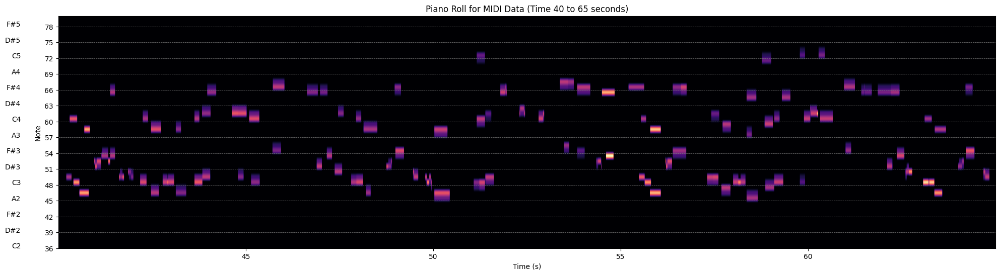

In [248]:
# Example usage:
plot_piano_roll(midi_data, L_time=40, R_time=65, start_pitch=36, end_pitch=80)

#### Examples, magenta color, ASR-whisper

In [256]:
os.listdir(vocal_tracks_folder)

['Heartbeat - Childish Gambino',
 'Кристаллические лярвы',
 'Не киряй',
 'Lucid WRLD - Yang_d Out (prod. Drew Banga)',
 'Пошлая Молли, Элджей - Дом Периньон',
 'Самый лучший эмо панк',
 'Температура',
 'Фотографирую закат',
 'Типичная вечеринка с бассейном',
 'ПОШЛАЯ МОЛЛИ –СУПЕРМАРКЕТ  [320 kbps]',
 'Беги от меня',
 'ПОШЛАЯ МОЛЛИ - НОН СТОП',
 'Marshmello-feat-Omar-Linx_-_Keep-It-Mello',
 'Даже моя бэйби не знает',
 'Ed Sheeran - Shape Of You',
 'Беспечный рыцарь тьмы',
 'Justin Bieber - What Do You Mean',
 'Демоны',
 'alan-walker-fade',
 'Martin Garrix — Animals',
 'the_chainsmokers_feat_halsey_-_closer_(zf.fm)',
 'АДЛИН, Килджо - Одна (MP3SUN.net)',
 'apologize',
 'Райские цветы',
 'Проиграли',
 'Аутоагрессия',
 'pascal_letoublon_friendships',
 'Все хотят меня поцеловать',
 'Адлин - Dead inside (Muzten.net)',
 'mxnarch - Nightwing',
 'Я и одиночество',
 'Coldplay — The Scientist',
 'Контракт',
 'DEAD BLONDE - Мальчик на девятке',
 'ПОШЛАЯ МОЛЛИ - Контракт',
 'Буду твоим пёс

100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 8268/8268 [01:08<00:00, 121.53frames/s]


 Мощь, да, офицерит глупо Визг, да, циволь, стресс, меня теряет вести Ну а что потом, вы, дед, вам, бесек, хо Дедиш, да, вы, дедиш, хо Дедиш, да, вы, дедиш, хо План бесек, хо, дедиш, да План бесек, хо, дедиш, да План, пыль, план Он не вернется, ты оттайти, пыль, сам Мы-тка-дом Играй со мной Мы-тка-дом, дай мне лайк, упадем А теперь не сады в странные вечеринки с бомжом Вечеринки с бомжом Вечеринки с бомжом Утой, не сады в странные вечеринки с бомжом А теперь не сады в странные вечеринки с бомжом
Predicting MIDI for ../demucs_separated/mdx_extra/Буду твоим пёсиком/vocals.mp3...


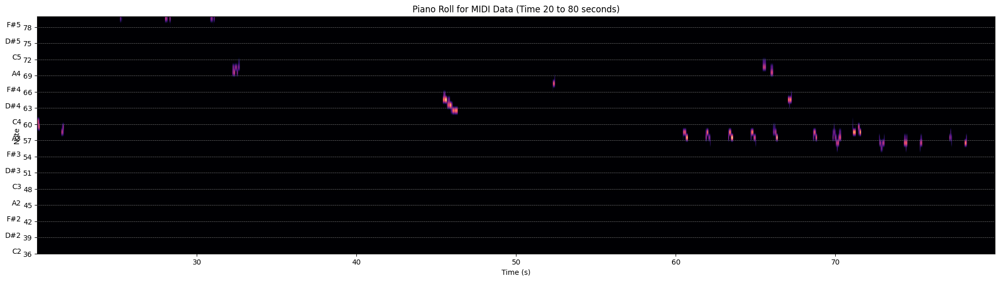

100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 8268/8268 [01:15<00:00, 109.44frames/s]


 И опусти меня, парни, на краске цветы Детка, смотри, теперь я именно тот Который бы ты как-то делал без своей пиздри Теперь, малышка, не увидишь мою горькую тясть Я это в новой те купил, я с лицом сковардил Амп захожу на пати, раздаваю попаст На меня все смотрят, потому что классный Ты за них откроешь, волоски шмот Парш, ты простащик, у как ты лет на садку Руси на мою дежу, не убежал я в один Эдит у меня, бросил не в бычу, в тебя войти, о Руси на мою дежу, не убежал я в один Казином, а держаться зашли нам не по пути Немного на пути, не упадки, не Манова подешка, подшипки, разобьешь, веш Ты купил, ты убежал, поделил, и опустил меня на поле Раз, если ты, раз, раз, если ты Раз, если ты, раз, раз, если ты Я не сладкий, не опустил, раз, если ты Раз, если ты, раз, раз, если ты Я за днем полы, опустил, раз, если ты
Predicting MIDI for ../demucs_separated/mdx_extra/Райские цветы/vocals.mp3...


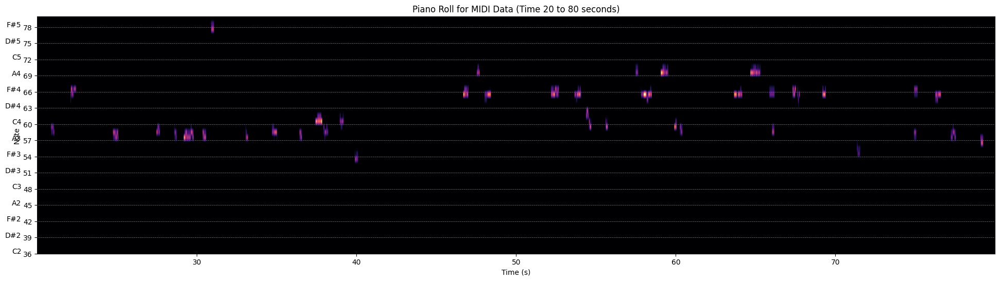

100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 8268/8268 [01:00<00:00, 136.02frames/s]


 С подальшими гами, я бы пришлась на тебя инстаграме А у меня снега таска, я смешно бежамя Снова идти в суббай, хотеть запретить до вот конца Мне все равно прилететь к тебе на свадьбу А здесь сирота с ума сука сука сука ай Прыгнув в тобой никто не поймал От ловла циндажу не вытаса Сука сука сука сука сука сука ай Все хотят меня поцеловать Целоваться Сука сука сука сука сука сука ай Прыгнув в тобой никто не поймал Никто не поймал Ебать Сука сука сука сука сука ай Все хотят меня поцеловать Целоваться Насильные мочалки Кричали пачечной кричалки А все еще любят и блесны девчанку Злые как у собак
Predicting MIDI for ../demucs_separated/mdx_extra/Все хотят меня поцеловать/vocals.mp3...


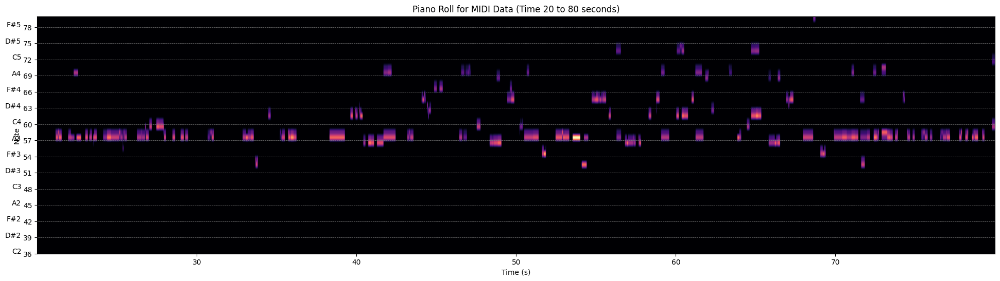

100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 8268/8268 [00:43<00:00, 190.50frames/s]


 Снежем пертом Родной портвей номер 777 С друзьями спалят под мостом Мне снился сон Мне снился сон Я пидею, что тем-то тём И не забуду никогда Живки в сон Которым разбудили мусора Сколько быч на пентам И пацаны, меня не хватит Мне срочно нужен супермаркет Мой сердечко отстрадает Мне срочно нужен супермаркет А что потом? Люблю ловить снежем герцог
Predicting MIDI for ../demucs_separated/mdx_extra/ПОШЛАЯ МОЛЛИ –СУПЕРМАРКЕТ  [320 kbps]/vocals.mp3...


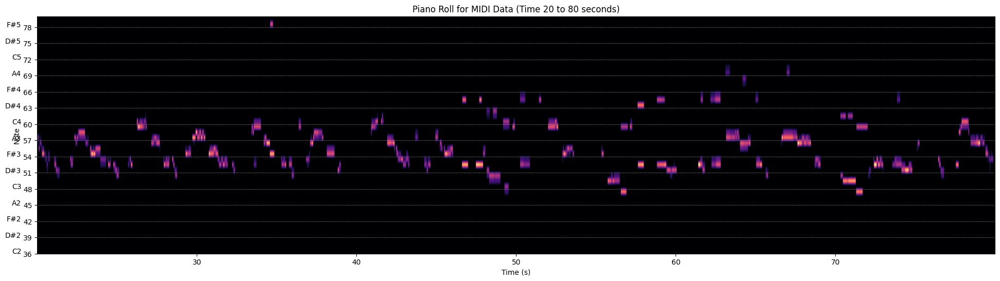

 99%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏| 8216/8268 [01:52<00:00, 72.88frames/s]


 Деваны, деваны, деваны, деваны, деваны, деваны, деваны, деваны, деваны, деваны, деваны, деваны, деваны, деваны, деваны, деваны, деваны, деваны, деваны, деваны, деваны, деваны, деваны, деваны, деваны, деваны, деваны, деваны, деваны, деваны, деваны, деваны, деваны, деваны, деваны, деваны, деваны, деваны, деваны, деваны, деваны, деваны, деваны, деваны, деваны, деваны, деваны, деваны, деваны, деваны, деваны, деваны, деваны, деваны, деваны, деваны, деваны, деваны, деваны, деваны, деваны, деваны, деваны, деваны, деваны, деваны, деваны, деваны, деваны, деваны, деваны, деваны, деваны, деваны, твоей ладони влажной ты славила бы, ай, тронки не спасут, ты снова ищешь меня, я всем телом, но душой застрял в границах на час, преисполняясь алкоголем, кто в последний раз, а это небо, он стоит тебя хранить без конца, я чувствую, как в мою грудь входит бензобила, эти два драма вернут мне мое лицо, собаки лаквы, я с ними, но тебе все равно. Вон, на храницкну, в чизовозу сигареты на балконе, я вернусь и 

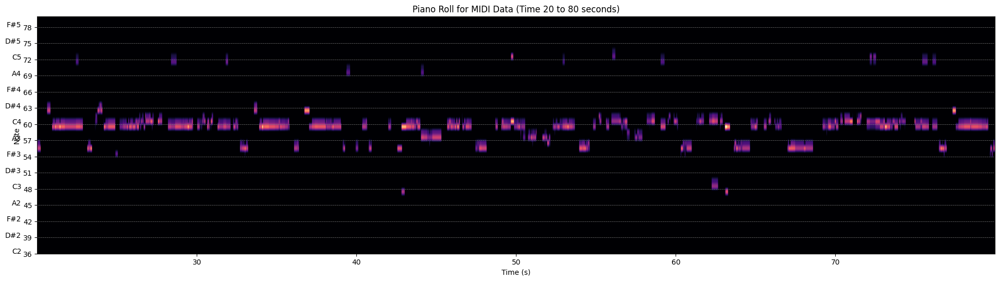

100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 8268/8268 [00:48<00:00, 171.67frames/s]


 На неба принято острый символ Но в ахота убен Еду за рулем, пытаюсь написать помин Сирит мне к лицу Воги я враю Охо, все вижу Тупо торрежу Телайте мой контракт Весельки на моих руках Куклу мастер хай Не падай, но в любви клялась Дядька, я влюблен Эй, покажи мне все себя Я не поняла Телайте мой контракт Весельки на моих руках Куклу мастер хай Не падай, но в любви клялась Дядька, я влюблен Эй, покажи мне все себя Я не поняла Яу-яу
Predicting MIDI for ../demucs_separated/mdx_extra/Контракт/vocals.mp3...


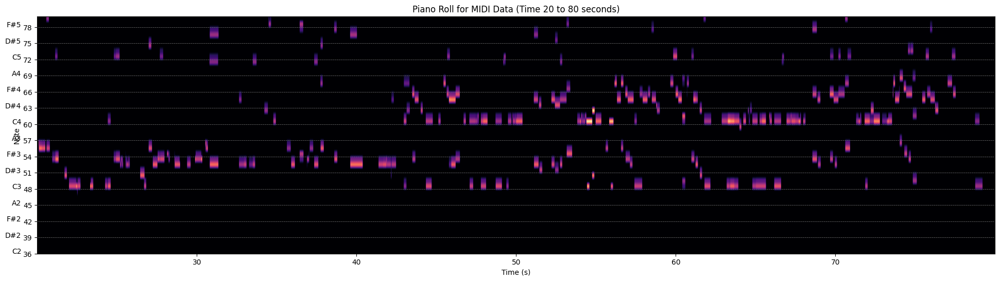

In [258]:
vocal_tracks_folder = '../demucs_separated/mdx_extra/'
# for subdir in sorted(os.listdir(vocal_tracks_folder)):
for subdir in ['Буду твоим пёсиком', 'Райские цветы', 'Все хотят меня поцеловать', 'ПОШЛАЯ МОЛЛИ –СУПЕРМАРКЕТ  [320 kbps]', 'Демоны', 'Контракт']:
    audio_path = os.path.join(vocal_tracks_folder, subdir, 'vocals.mp3')
    y, sr = librosa.load(audio_path)
    result = whisper.transcribe(model_medium, y[20 * sr:80 * sr], language="ru")
    print(result['text'])
    model_output, midi_data, note_events = predict(audio_path)
    plot_piano_roll(midi_data, L_time=20, R_time=80, start_pitch=36, end_pitch=80)

100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 8268/8268 [00:39<00:00, 208.21frames/s]


 Без тебя Вон как я виду иссока Будто парой на казах Без тебя Без тебя Уйди, моем сердце Свечка снут Становлюсь холодным Молчи все не вечно Все неважно Я умру свободным Я не вижу лет, я вижу твой нутро Без жизни вон мне не нравится ничего Просто прекрати Паспаспасщать мои обынные сны Вот так как ирую из сока Будто парой на казах Без тебя Вот так как ирую из сока Будто парой на казах Без тебя
Predicting MIDI for ../demucs_separated/mdx_extra/Фотографирую закат/vocals.mp3...


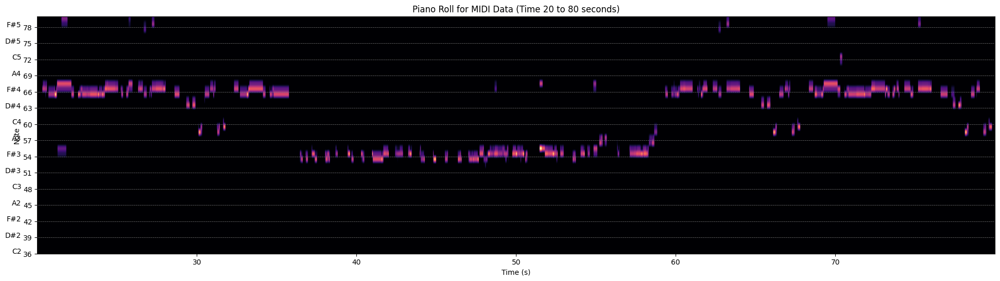

100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 8268/8268 [00:53<00:00, 155.86frames/s]


 Каждый миллиметр филиграммой сболосанной руки Чувствует этот холод, но оно почему до сих пор не ушло Второй дышой, с которой вместе подданем Я случайно оказалась тем, из кем мне проще убегать От моих собственных страхов, но оно почему мне так легко Ищет ралин и сыпает на рано соленую Служу моя паса, метил мюткой тенон И все мои законы закручат венец тенон Лизба, это бусон, дировая новая вдох Лизба, это бусон, медленная новая вдох Служу моя паса, метил мюткой тенон И все мои законы закручат венец тенон Лизба, это бусон, дировая новая вдох Лизба...
Predicting MIDI for ../demucs_separated/mdx_extra/Вдох/vocals.mp3...


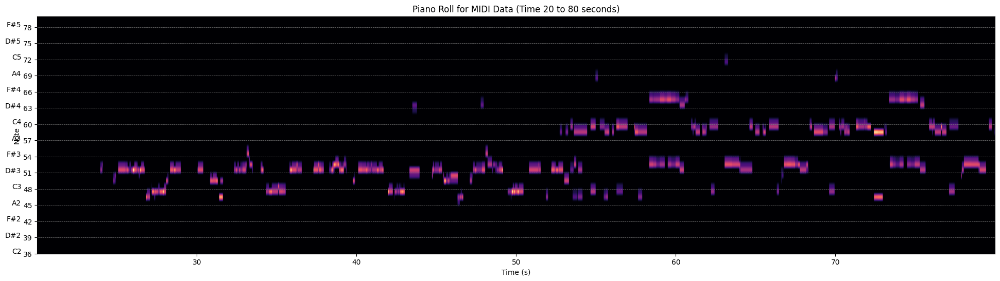

In [260]:
for subdir in ['Фотографирую закат', 'Вдох']:
    audio_path = os.path.join(vocal_tracks_folder, subdir, 'vocals.mp3')
    y, sr = librosa.load(audio_path)
    result = whisper.transcribe(model_medium, y[20 * sr:80 * sr], language="ru")
    print(result['text'])
    model_output, midi_data, note_events = predict(audio_path)
    plot_piano_roll(midi_data, L_time=20, R_time=80, start_pitch=36, end_pitch=80)

### (3)Visualization of Contor, Note

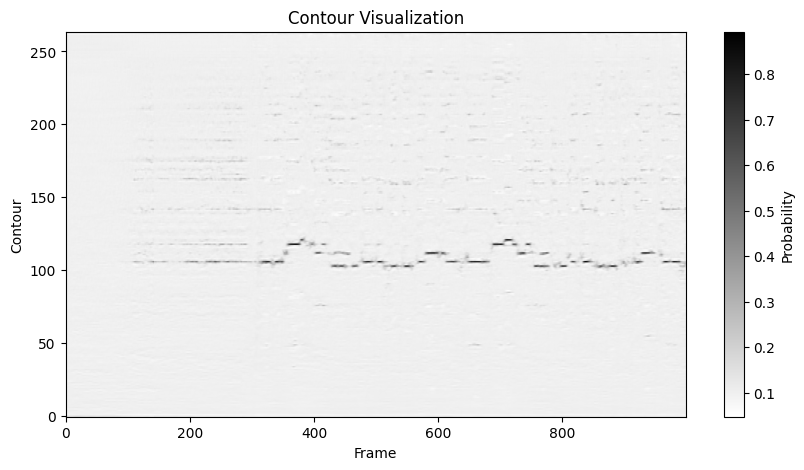

In [48]:
plt.figure(figsize=(10, 5))
plt.imshow(model_output['contour'][:1000,].T, aspect='auto', origin='lower', cmap='binary')
plt.xlabel('Frame')
plt.ylabel('Contour')
plt.title('Contour Visualization')
plt.colorbar(label='Probability')
plt.show()

In [199]:
model_output, midi_data, note_events = predict(contract)

Predicting MIDI for ../demucs_separated/mdx_extra/ПОШЛАЯ МОЛЛИ - Контракт/vocals.mp3...


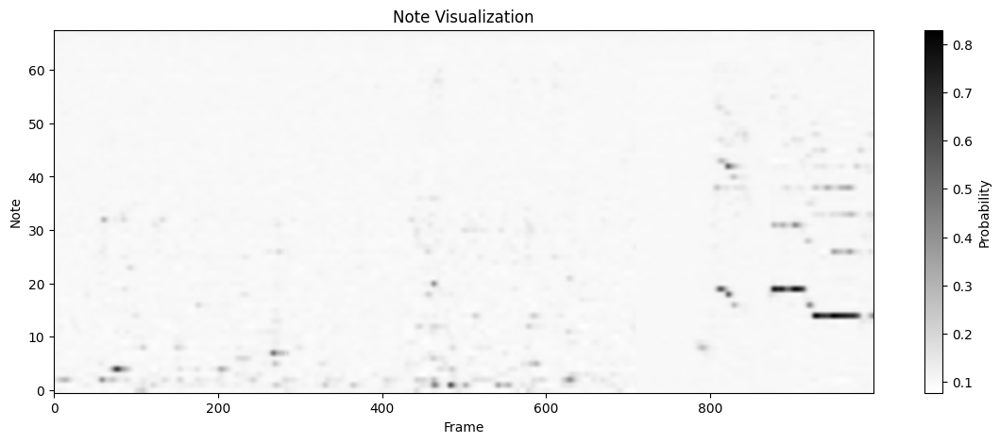

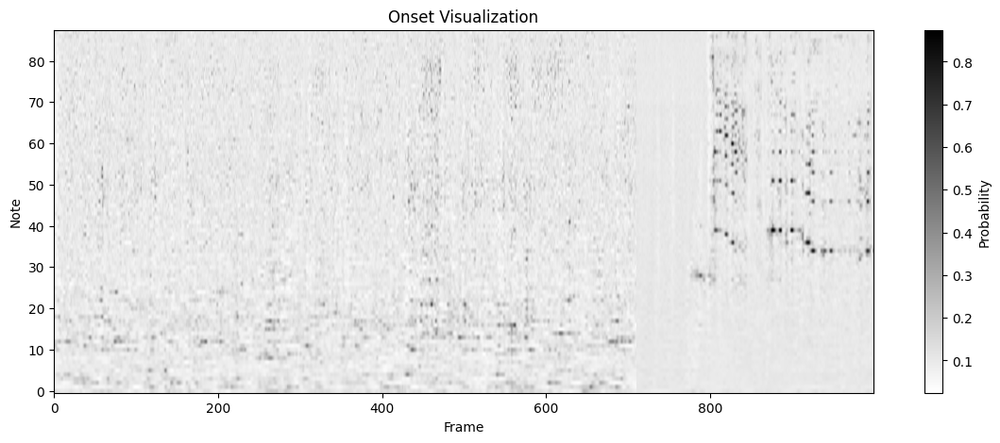

In [151]:
plt.figure(figsize=(14, 5))
plt.imshow(model_output['note'][:1000, 20:90].T, aspect='auto', origin='lower', cmap='binary')
plt.xlabel('Frame')
plt.ylabel('Note')
plt.title('Note Visualization')
plt.colorbar(label='Probability')
plt.show()

plt.figure(figsize=(14, 5))
plt.imshow(model_output['onset'][:1000].T, aspect='auto', origin='lower', cmap='binary')
plt.xlabel('Frame')
plt.ylabel('Note')
plt.title('Onset Visualization')
plt.colorbar(label='Probability')
plt.show()


#### IMPROVING WITH GPT-4

RHYTMIC_GRID

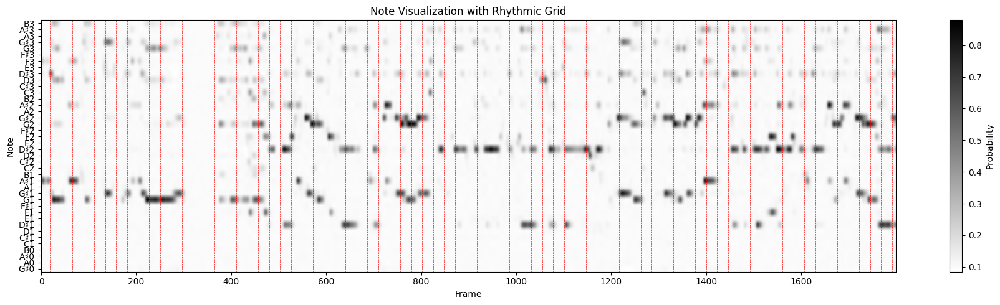

In [191]:
import numpy as np
import matplotlib.pyplot as plt
import librosa

def plot_note_visualization(model_output, bpm, L, R, L_note, R_note):
    """
    Plots a note visualization with rhythmic grid based on the given bpm.

    Parameters:
    - model_output: Dictionary containing 'note' which is a 2D array of note probabilities
    - bpm: Beats per minute for the rhythmic grid
    - L, R: Left and Right frame indices to slice the model output for visualization
    - L_note, R_note: Lowest and highest MIDI note numbers to display on the y-axis
    """
    sr = 22050  # Sample rate
    hop_length = 512  # Hop length
    beat_frame_interval = (sr * 60) // (bpm * hop_length)
    
    # Calculate probability range for contrast
    prob_min = np.min(model_output['note'][L:R, L_note:R_note])
    prob_max = np.max(model_output['note'][L:R, L_note:R_note])

    plt.figure(figsize=(18, 5))
    plt.imshow(model_output['note'][L:R, L_note:R_note].T, aspect='auto', origin='lower',
               cmap='binary', vmin=prob_min, vmax=prob_max)
    plt.xlabel('Frame')
    plt.ylabel('Note')

    # Add vertical lines for beats
    L_ = 0=
    while L_ < L:
        L_ += beat_frame_interval
    for i in range(L_, R, beat_frame_interval):
        plt.axvline(x=i-L, color='red', linestyle='--', linewidth=0.5)  # Offset x by L

    # Map y-axis indices to MIDI notes, then to note names
    note_range = range(L_note, R_note)
    note_names = [librosa.midi_to_note(n) for n in note_range]
    plt.yticks(range(len(note_names)), note_names)

    plt.title('Note Visualization with Rhythmic Grid')
    plt.colorbar(label='Probability')
    plt.tight_layout()  # Adjust layout to fit everything nicely
    plt.show()

plot_note_visualization(model_output, bpm=110, L=3200, R=5000, L_note=20, R_note=60)

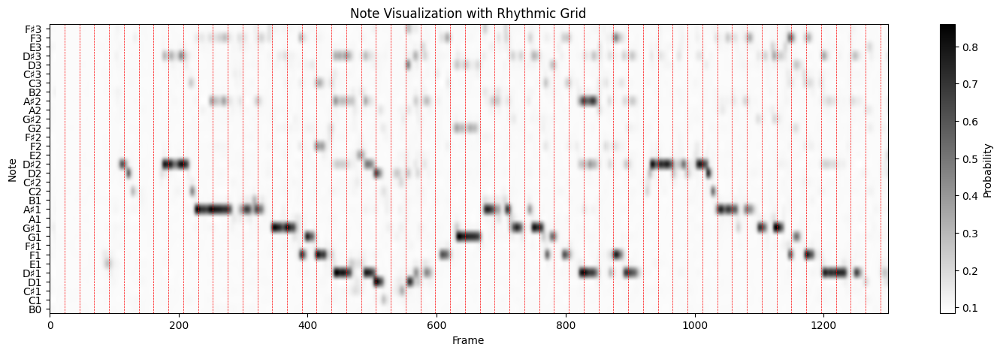

In [174]:
import numpy as np
import matplotlib.pyplot as plt


bpm = 110
sr = 22050
hop_length = 512
beat_frame_interval = (sr * 60) // (bpm * hop_length)
L, R = 700, 2000
L_note, R_note = 23, 55

# Plot note visualization
prob_min = np.min(model_output['note'][L:R, L_note:R_note])
prob_max = np.max(model_output['note'][L:R, L_note:R_note])

plt.figure(figsize=(18, 5))
# Slicing [20:70] is used to focus on a specific note range
plt.imshow(model_output['note'][L:R, L_note:R_note].T, aspect='auto', origin='lower', 
           cmap='binary', vmin=prob_min, vmax=prob_max)
plt.xlabel('Frame')
plt.ylabel('Note')

# Add vertical lines for beats
for i in range(0, R-L, beat_frame_interval):
    plt.axvline(x=i, color='red', linestyle='--',  linewidth=0.5)

# Map y-axis indices to MIDI notes, then to note names
note_range = range(L_note, R_note)  # Assuming these are the MIDI note numbers
note_names = [librosa.midi_to_note(n) for n in note_range]  # Convert MIDI numbers to note names
plt.yticks(range(len(note_names)), note_names)  # Set custom y-axis tick labels


plt.title('Note Visualization with Rhythmic Grid')
plt.colorbar(label='Probability')
plt.show()


### (3)Visualize Note_events

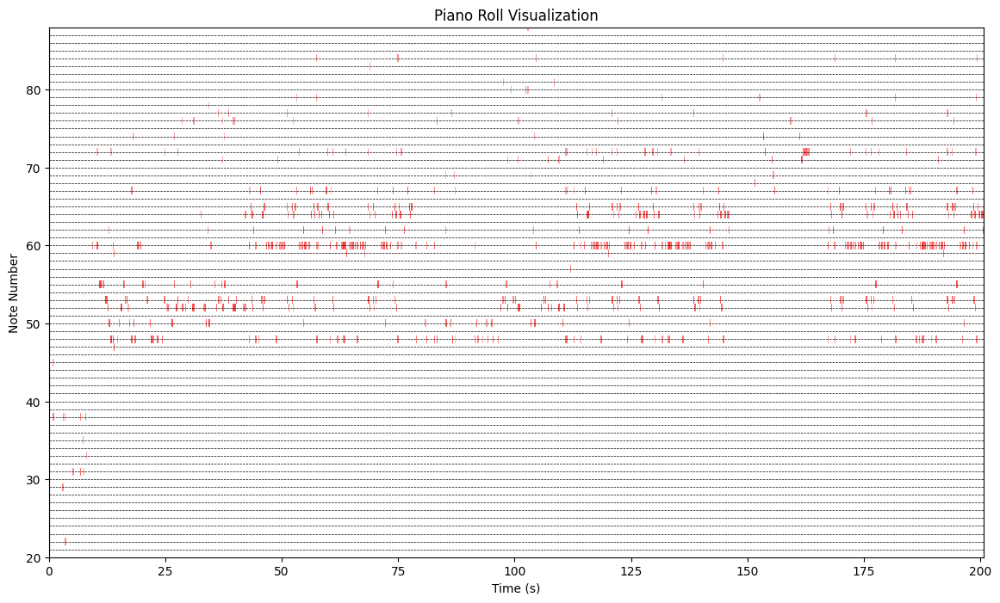

In [166]:
import matplotlib.pyplot as plt
import numpy as np

def plot_piano_roll(note_events):
    """
    Plots a piano roll visualization of note events.

    Parameters:
    - note_events: a list of tuples, each containing the start time, end time, note number, and confidence of a note event.
    """
    fig, ax = plt.subplots(figsize=(14, 8))

    # Define the piano roll range (e.g., 21 for A0, 108 for C8 in MIDI note numbers)
    piano_range = range(21, 109)  # Adjust this range to your specific needs
    ax.set_ylim(20, 88)  # This sets the y-axis to match the MIDI note numbers
    ax.set_xlim(0, max([end for start, end, note, conf, _ in note_events]))  # Time range

    # Add a horizontal line for each possible note
    for note in piano_range:
        ax.axhline(y=note, color='k', linewidth=0.5, linestyle='--')

    # Plot each note event
    for start_time, end_time, note_num, confidence, _ in note_events:
        ax.add_patch(plt.Rectangle((start_time, note_num-0.5), end_time-start_time, 1, 
                                   edgecolor='none', facecolor=(1, 0, 0, confidence)))

    ax.set_xlabel('Time (s)')
    ax.set_ylabel('Note Number')
    ax.set_title('Piano Roll Visualization')

    plt.show()

# Example usage:
# note_events = [(start_time, end_time, note_num, confidence, binary_list), (...), ...]
plot_piano_roll(note_events)


## WHISPER

Timestamped

#### Preparing (4)

In [77]:
!pip3 install whisper-timestamped -q

In [51]:
import whisper_timestamped
help(whisper_timestamped.transcribe)

Importing the dtw module. When using in academic works please cite:
  T. Giorgino. Computing and Visualizing Dynamic Time Warping Alignments in R: The dtw Package.
  J. Stat. Soft., doi:10.18637/jss.v031.i07.

Help on function transcribe_timestamped in module whisper_timestamped.transcribe:

transcribe_timestamped(model, audio, language=None, task='transcribe', remove_punctuation_from_words=False, compute_word_confidence=True, include_punctuation_in_confidence=False, refine_whisper_precision=0.5, min_word_duration=0.02, plot_word_alignment=False, word_alignement_most_top_layers=None, remove_empty_words=False, use_backend_timestamps=False, seed=1234, vad=False, detect_disfluencies=False, trust_whisper_timestamps=True, naive_approach=False, temperature=0.0, best_of=None, beam_size=None, patience=None, length_penalty=None, compression_ratio_threshold=2.4, logprob_threshold=-1.0, no_speech_threshold=0.6, fp16=None, condition_on_previous_text=True, initial_prompt=None, suppress_tokens='-1',

#### Example (4)

In [53]:
audio_path = '../demucs_separated/mdx_extra/Ed Sheeran - Shape Of You/vocals.mp3'
# audio_path = '../demucs_separated/mdx_extra/ПОШЛАЯ МОЛЛИ - Контракт/vocals.mp3'

In [ ]:
import whisper_timestamped as whisper

audio = whisper.load_audio(audio_path)

model = whisper.load_model("tiny", device="cpu")

result = whisper.transcribe(model, audio, language="fr")

import json
print(json.dumps(result, indent = 2, ensure_ascii = False))

In [60]:
audio_path = '../demucs_separated/mdx_extra/ПОШЛАЯ МОЛЛИ - Контракт/vocals.mp3'
audio_path = '../demucs_separated/mdx_extra/Ed Sheeran - Shape Of You/vocals.mp3'
audio = whisper.load_audio(audio_path)
result = whisper.transcribe(model, audio, language="en")
print(json.dumps(result, indent=2, ensure_ascii = False))

100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 23382/23382 [00:12<00:00, 1809.46frames/s]

{
  "text": " The car doesn't have the best place to find the lovers of the baris where I go. Me and my friends at the table doing shots just too fast and then we talk slow. And come over and start the conversation with just me and trust me I'll give it just now. And stop depending on the jukebox and then we start to dance and now I've seen it like girl you know I won't show love. Your love was hand made for somebody like me. Coming now follow my lead. I may be crazy, don't mind me, say boy, let's not talk too much. Grab on my waist and put that body on me. Coming now follow my lead, coming now follow my lead. I'm in love with the shape of you with the shampoo like a magnet. All through my heart is full empty. I'm in love with your body. Unless I chew it in my room and I'm a bad sheet smell like you. Everybody discover in something brand. I'm in love with your body. I'm in love with your body. I'm in love with your body. I'm in love with your body. Everybody discover in something brand

#### Load model base, medium, new example

In [75]:
model = whisper.load_model("base", device="cpu")

100%|████████████████████████████████████████| 139M/139M [05:58<00:00, 406kiB/s]


In [99]:
model_medium = whisper.load_model("medium", device="cpu")

In [103]:
audio_path = '../demucs_separated/mdx_extra/ПОШЛАЯ МОЛЛИ - Контракт/vocals.mp3'
# audio_path = '../demucs_separated/mdx_extra/Ed Sheeran - Shape Of You/vocals.mp3'
y, sr = librosa.load(audio_path)
audio = y # whisper.load_audio(audio_path)
result = whisper.transcribe(model_medium, audio, language="ru")
result.keys()

100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 28224/28224 [03:53<00:00, 120.69frames/s]


dict_keys(['text', 'segments', 'language'])

#### complex solution

In [116]:
def merge_results(results):
    merged_result = {'text': [], 'segments': [], 'language': 'ru'}
    for result in results:
        merged_result['text'].append(result['text'])
        merged_result['segments'].append(result['segments'])
    merged_result['text'] = ''.join(merged_result['text'])
    return merged_result

def chunk_transcribe(audio_path, TAKT):
    y, sr = librosa.load(audio_path)
    timestamp = 0
    eps = 0.01
    results = []
    while timestamp * sr < len(y):
        L = int(timestamp * sr + eps)
        R = int((timestamp + TAKT) * sr + eps)
        cur_result = whisper.transcribe(model_medium, y[L:R], language="ru")
        if DEBUG:
            print("timestamp:", timestamp)
            print("current_text:", cur_result['text'])
            for seg in cur_result['segments']:
                print("words:", seg['words'])
        results.append(cur_result)
        timestamp += TAKT
    return merge_results(results)

DEBUG = True
TAKT = 16 / 110 * 60
contract = '../demucs_separated/mdx_extra/ПОШЛАЯ МОЛЛИ - Контракт/vocals.mp3'
contract_result = chunk_transcribe(contract, TAKT)

  0%|                                                                                                                                         | 0/1202 [00:04<?, ?frames/s]


timestamp: 0
current_text: 


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 1202/1202 [00:07<00:00, 160.17frames/s]


timestamp: 8.727272727272727
current_text:  Я вчера был к вам, утром проспал на маникюр, блин, боже господи, помоги понять, чем я пойду.
words: [{'text': 'Я', 'start': 0.68, 'end': 1.64, 'confidence': 0.258}, {'text': 'вчера', 'start': 1.64, 'end': 2.28, 'confidence': 0.934}, {'text': 'был', 'start': 2.28, 'end': 2.68, 'confidence': 0.989}, {'text': 'к', 'start': 2.68, 'end': 2.88, 'confidence': 0.503}, {'text': 'вам,', 'start': 2.88, 'end': 3.26, 'confidence': 0.757}, {'text': 'утром', 'start': 3.74, 'end': 4.32, 'confidence': 0.793}, {'text': 'проспал', 'start': 4.32, 'end': 4.9, 'confidence': 0.916}, {'text': 'на', 'start': 4.9, 'end': 5.38, 'confidence': 0.97}, {'text': 'маникюр,', 'start': 5.38, 'end': 6.8, 'confidence': 0.972}, {'text': 'блин,', 'start': 7.14, 'end': 7.72, 'confidence': 0.807}, {'text': 'боже', 'start': 8.0, 'end': 8.32, 'confidence': 0.752}, {'text': 'господи,', 'start': 8.32, 'end': 9.76, 'confidence': 0.965}, {'text': 'помоги', 'start': 9.88, 'end': 10.36, 'co

100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 1202/1202 [00:08<00:00, 149.99frames/s]


timestamp: 17.454545454545453
current_text:  СИО Миллион проблем На неба наняту острых символ На вам как-то улыбан Я за рулем пытаюсь написать
words: [{'text': 'СИО', 'start': 0.02, 'end': 1.54, 'confidence': 0.089}]
words: [{'text': 'Миллион', 'start': 1.82, 'end': 2.66, 'confidence': 0.761}, {'text': 'проблем', 'start': 2.66, 'end': 3.68, 'confidence': 0.971}]
words: [{'text': 'На', 'start': 3.72, 'end': 3.96, 'confidence': 0.464}, {'text': 'неба', 'start': 3.96, 'end': 4.6, 'confidence': 0.862}, {'text': 'наняту', 'start': 4.6, 'end': 5.4, 'confidence': 0.626}, {'text': 'острых', 'start': 5.4, 'end': 6.0, 'confidence': 0.704}, {'text': 'символ', 'start': 6.0, 'end': 6.48, 'confidence': 0.855}]
words: [{'text': 'На', 'start': 6.48, 'end': 6.5, 'confidence': 0.234}, {'text': 'вам', 'start': 6.5, 'end': 6.52, 'confidence': 0.245}, {'text': 'как-то', 'start': 6.52, 'end': 6.54, 'confidence': 0.616}, {'text': 'улыбан', 'start': 6.54, 'end': 7.5, 'confidence': 0.632}]
words: [{'text': 'Я'

100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 1202/1202 [00:04<00:00, 240.91frames/s]


timestamp: 26.18181818181818
current_text:  Понасилил мне клетку в огне, я в раю.
words: [{'text': 'Понасилил', 'start': 0.0, 'end': 1.92, 'confidence': 0.558}, {'text': 'мне', 'start': 1.92, 'end': 2.52, 'confidence': 0.919}, {'text': 'клетку', 'start': 2.52, 'end': 3.72, 'confidence': 0.673}, {'text': 'в', 'start': 3.72, 'end': 3.98, 'confidence': 0.374}, {'text': 'огне,', 'start': 3.98, 'end': 4.94, 'confidence': 0.358}, {'text': 'я', 'start': 5.12, 'end': 5.64, 'confidence': 0.797}, {'text': 'в', 'start': 5.64, 'end': 5.96, 'confidence': 0.749}, {'text': 'раю.', 'start': 5.96, 'end': 6.68, 'confidence': 0.693}]


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 1202/1202 [00:05<00:00, 221.47frames/s]


timestamp: 34.90909090909091
current_text:  Пока все вижу, тупо торрежу Целый темно
words: [{'text': 'Пока', 'start': 0.64, 'end': 1.52, 'confidence': 0.105}, {'text': 'все', 'start': 1.52, 'end': 2.44, 'confidence': 0.504}, {'text': 'вижу,', 'start': 2.44, 'end': 3.54, 'confidence': 0.849}, {'text': 'тупо', 'start': 3.92, 'end': 4.98, 'confidence': 0.81}, {'text': 'торрежу', 'start': 4.98, 'end': 7.22, 'confidence': 0.685}]
words: [{'text': 'Целый', 'start': 10.88, 'end': 11.7, 'confidence': 0.686}, {'text': 'темно', 'start': 11.7, 'end': 12.3, 'confidence': 0.634}]


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 1202/1202 [00:07<00:00, 152.96frames/s]


timestamp: 43.63636363636363
current_text:  Мой контракт, весельки на моих руках Куклы Monster High Не паряк, но блин ты клёра, стятка я
words: [{'text': 'Мой', 'start': 0.04, 'end': 0.52, 'confidence': 0.368}, {'text': 'контракт,', 'start': 0.52, 'end': 1.86, 'confidence': 0.99}, {'text': 'весельки', 'start': 2.24, 'end': 3.0, 'confidence': 0.694}, {'text': 'на', 'start': 3.0, 'end': 3.48, 'confidence': 0.944}, {'text': 'моих', 'start': 3.48, 'end': 4.26, 'confidence': 0.944}, {'text': 'руках', 'start': 4.26, 'end': 5.16, 'confidence': 0.989}]
words: [{'text': 'Куклы', 'start': 5.28, 'end': 6.08, 'confidence': 0.77}, {'text': 'Monster', 'start': 6.08, 'end': 6.6, 'confidence': 0.279}, {'text': 'High', 'start': 6.6, 'end': 7.54, 'confidence': 0.769}]
words: [{'text': 'Не', 'start': 7.86, 'end': 8.42, 'confidence': 0.88}, {'text': 'паряк,', 'start': 8.42, 'end': 9.06, 'confidence': 0.592}, {'text': 'но', 'start': 9.22, 'end': 9.32, 'confidence': 0.812}, {'text': 'блин', 'start': 9.32, '

  0%|                                                                                                                                         | 0/1202 [00:05<?, ?frames/s]


timestamp: 52.36363636363636
current_text: 


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 1202/1202 [00:09<00:00, 125.53frames/s]


timestamp: 61.090909090909086
current_text:  Македрак, висели кинома и круга Как у Мастер Хай, не паряк, но в любви клялась тяка
words: [{'text': 'Македрак,', 'start': 0.0, 'end': 1.7, 'confidence': 0.398}, {'text': 'висели', 'start': 2.22, 'end': 2.76, 'confidence': 0.532}, {'text': 'кинома', 'start': 2.76, 'end': 3.94, 'confidence': 0.683}, {'text': 'и', 'start': 3.94, 'end': 4.26, 'confidence': 0.797}, {'text': 'круга', 'start': 4.26, 'end': 5.28, 'confidence': 0.709}]
words: [{'text': 'Как', 'start': 5.3, 'end': 5.74, 'confidence': 0.234}, {'text': 'у', 'start': 5.74, 'end': 5.96, 'confidence': 0.208}, {'text': 'Мастер', 'start': 5.96, 'end': 6.84, 'confidence': 0.465}, {'text': 'Хай,', 'start': 6.84, 'end': 7.48, 'confidence': 0.839}, {'text': 'не', 'start': 8.0, 'end': 8.32, 'confidence': 0.8}, {'text': 'паряк,', 'start': 8.32, 'end': 9.06, 'confidence': 0.624}, {'text': 'но', 'start': 9.16, 'end': 9.34, 'confidence': 0.882}, {'text': 'в', 'start': 9.34, 'end': 9.52, 'confidence'

100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 1202/1202 [00:05<00:00, 234.66frames/s]


timestamp: 69.81818181818181
current_text:  Я влюблял, покажи мне все себя, я не поняла
words: [{'text': 'Я', 'start': 0.0, 'end': 0.26, 'confidence': 0.249}, {'text': 'влюблял,', 'start': 0.26, 'end': 1.8, 'confidence': 0.671}, {'text': 'покажи', 'start': 2.1, 'end': 3.28, 'confidence': 0.432}, {'text': 'мне', 'start': 3.28, 'end': 3.74, 'confidence': 0.973}, {'text': 'все', 'start': 3.74, 'end': 4.24, 'confidence': 0.531}, {'text': 'себя,', 'start': 4.24, 'end': 5.04, 'confidence': 0.932}, {'text': 'я', 'start': 5.32, 'end': 5.62, 'confidence': 0.678}, {'text': 'не', 'start': 5.62, 'end': 6.14, 'confidence': 0.99}, {'text': 'поняла', 'start': 6.14, 'end': 7.4, 'confidence': 0.985}]


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 1202/1202 [00:06<00:00, 179.71frames/s]


timestamp: 78.54545454545453
current_text:  Я спасибо всем, что вышли, за мной висит должок. Это было очень мило от своей стороны, но я хочу
words: [{'text': 'Я', 'start': 0.0, 'end': 0.88, 'confidence': 0.148}, {'text': 'спасибо', 'start': 0.88, 'end': 2.5, 'confidence': 0.115}, {'text': 'всем,', 'start': 2.5, 'end': 3.04, 'confidence': 0.67}, {'text': 'что', 'start': 3.46, 'end': 3.48, 'confidence': 0.202}, {'text': 'вышли,', 'start': 3.48, 'end': 4.44, 'confidence': 0.663}, {'text': 'за', 'start': 4.84, 'end': 5.22, 'confidence': 0.755}, {'text': 'мной', 'start': 5.22, 'end': 5.46, 'confidence': 0.417}, {'text': 'висит', 'start': 5.46, 'end': 6.1, 'confidence': 0.885}, {'text': 'должок.', 'start': 6.1, 'end': 7.04, 'confidence': 0.692}]
words: [{'text': 'Это', 'start': 7.94, 'end': 8.32, 'confidence': 0.952}, {'text': 'было', 'start': 8.32, 'end': 8.76, 'confidence': 0.964}, {'text': 'очень', 'start': 8.76, 'end': 9.12, 'confidence': 0.923}, {'text': 'мило', 'start': 9.12, 'end': 9.

100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 1202/1202 [00:10<00:00, 109.55frames/s]


timestamp: 87.27272727272725
current_text:  Еще двадцать лямов патрищиков Личика как у вибера Сумы тупой неприличные, чтобы было сыно Говори, что ты не смейся
words: [{'text': 'Еще', 'start': 1.82, 'end': 1.84, 'confidence': 0.098}, {'text': 'двадцать', 'start': 1.84, 'end': 2.28, 'confidence': 0.705}, {'text': 'лямов', 'start': 2.28, 'end': 2.76, 'confidence': 0.684}, {'text': 'патрищиков', 'start': 2.76, 'end': 4.02, 'confidence': 0.807}]
words: [{'text': 'Личика', 'start': 4.84, 'end': 5.4, 'confidence': 0.604}, {'text': 'как', 'start': 5.4, 'end': 5.76, 'confidence': 0.798}, {'text': 'у', 'start': 5.76, 'end': 6.04, 'confidence': 0.947}, {'text': 'вибера', 'start': 6.04, 'end': 6.86, 'confidence': 0.684}]
words: [{'text': 'Сумы', 'start': 7.86, 'end': 8.3, 'confidence': 0.823}, {'text': 'тупой', 'start': 8.3, 'end': 8.7, 'confidence': 0.64}, {'text': 'неприличные,', 'start': 8.7, 'end': 9.7, 'confidence': 0.687}, {'text': 'чтобы', 'start': 9.9, 'end': 10.06, 'confidence': 0.475}, {

100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 1202/1202 [00:05<00:00, 225.09frames/s]


timestamp: 95.99999999999997
current_text:  Лишний мурак стар, я не скрою всё, что я люблю
words: [{'text': 'Лишний', 'start': 0.0, 'end': 0.64, 'confidence': 0.395}, {'text': 'мурак', 'start': 0.64, 'end': 1.2, 'confidence': 0.368}, {'text': 'стар,', 'start': 1.2, 'end': 1.66, 'confidence': 0.443}, {'text': 'я', 'start': 2.0, 'end': 2.62, 'confidence': 0.834}, {'text': 'не', 'start': 2.62, 'end': 3.08, 'confidence': 0.946}, {'text': 'скрою', 'start': 3.08, 'end': 3.74, 'confidence': 0.319}, {'text': 'всё,', 'start': 3.74, 'end': 4.12, 'confidence': 0.398}, {'text': 'что', 'start': 4.42, 'end': 4.86, 'confidence': 0.979}, {'text': 'я', 'start': 4.86, 'end': 5.78, 'confidence': 0.976}, {'text': 'люблю', 'start': 5.78, 'end': 6.5, 'confidence': 0.987}]


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 1202/1202 [00:06<00:00, 172.99frames/s]


timestamp: 104.72727272727269
current_text:  Съемки, интервью, шмопки, аутю, дежавю Целуйте мне
words: [{'text': 'Съемки,', 'start': 0.56, 'end': 1.92, 'confidence': 0.636}, {'text': 'интервью,', 'start': 2.52, 'end': 3.62, 'confidence': 0.907}, {'text': 'шмопки,', 'start': 3.84, 'end': 4.88, 'confidence': 0.834}, {'text': 'аутю,', 'start': 5.56, 'end': 6.88, 'confidence': 0.255}, {'text': 'дежавю', 'start': 7.58, 'end': 9.2, 'confidence': 0.86}]
words: [{'text': 'Целуйте', 'start': 10.88, 'end': 11.94, 'confidence': 0.857}, {'text': 'мне', 'start': 11.94, 'end': 12.32, 'confidence': 0.468}]


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 1202/1202 [00:09<00:00, 131.60frames/s]


timestamp: 113.45454545454541
current_text:  Мой контракт, весельки на моих руках Кукума с рухой, не паникно в любви клялась Дядька я
words: [{'text': 'Мой', 'start': 0.0, 'end': 0.44, 'confidence': 0.428}, {'text': 'контракт,', 'start': 0.44, 'end': 1.82, 'confidence': 0.993}, {'text': 'весельки', 'start': 2.26, 'end': 3.04, 'confidence': 0.701}, {'text': 'на', 'start': 3.04, 'end': 3.48, 'confidence': 0.949}, {'text': 'моих', 'start': 3.48, 'end': 4.22, 'confidence': 0.943}, {'text': 'руках', 'start': 4.22, 'end': 5.18, 'confidence': 0.966}]
words: [{'text': 'Кукума', 'start': 5.34, 'end': 6.38, 'confidence': 0.458}, {'text': 'с', 'start': 6.38, 'end': 6.56, 'confidence': 0.661}, {'text': 'рухой,', 'start': 6.56, 'end': 7.54, 'confidence': 0.58}, {'text': 'не', 'start': 8.02, 'end': 8.32, 'confidence': 0.811}, {'text': 'паникно', 'start': 8.32, 'end': 9.26, 'confidence': 0.588}, {'text': 'в', 'start': 9.26, 'end': 9.54, 'confidence': 0.589}, {'text': 'любви', 'start': 9.54, 'end': 10

  0%|                                                                                                                                         | 0/1202 [00:03<?, ?frames/s]


timestamp: 122.18181818181813
current_text: 


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 1202/1202 [00:08<00:00, 137.21frames/s]


timestamp: 130.90909090909085
current_text:  Макадрак, весельки на моей кругах Ух, ума с рыхай, не падай, Но, блин, ты клялась, тетка!
words: [{'text': 'Макадрак,', 'start': 0.0, 'end': 1.7, 'confidence': 0.286}, {'text': 'весельки', 'start': 2.24, 'end': 3.1, 'confidence': 0.599}, {'text': 'на', 'start': 3.1, 'end': 3.5, 'confidence': 0.413}, {'text': 'моей', 'start': 3.5, 'end': 4.1, 'confidence': 0.938}, {'text': 'кругах', 'start': 4.1, 'end': 5.33, 'confidence': 0.589}]
words: [{'text': 'Ух,', 'start': 5.33, 'end': 5.82, 'confidence': 0.605}, {'text': 'ума', 'start': 5.98, 'end': 6.42, 'confidence': 0.523}, {'text': 'с', 'start': 6.42, 'end': 6.6, 'confidence': 0.923}, {'text': 'рыхай,', 'start': 6.6, 'end': 7.5, 'confidence': 0.569}, {'text': 'не', 'start': 7.98, 'end': 8.3, 'confidence': 0.867}, {'text': 'падай,', 'start': 8.3, 'end': 8.92, 'confidence': 0.839}]
words: [{'text': 'Но,', 'start': 8.94, 'end': 9.28, 'confidence': 0.507}, {'text': 'блин,', 'start': 9.28, 'end': 9.78,

100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 1202/1202 [00:31<00:00, 37.66frames/s]


timestamp: 139.63636363636357
current_text:  Я не поняла. Я не поняла. Я не поняла. Я не поняла. Я не поняла. Я не поняла. Я не поняла. Я не поняла. Я не поняла. Я не поняла. Я не поняла. Я не поняла. Я не поняла. Я не поняла. Я не поняла. Я не поняла. Я не поняла. Я не поняла. Я не поняла. Я не поняла. Я не поняла. Я не поняла. Я не поняла. Я не поняла. Я не поняла. Я не поняла. Я не поняла. Я не поняла. Я не поняла.
words: [{'text': 'Я', 'start': 0.0, 'end': 0.06, 'confidence': 0.073}, {'text': 'не', 'start': 0.06, 'end': 0.4, 'confidence': 0.392}, {'text': 'поняла.', 'start': 0.4, 'end': 0.9, 'confidence': 0.55}]
words: [{'text': 'Я', 'start': 0.9, 'end': 0.92, 'confidence': 0.121}, {'text': 'не', 'start': 0.92, 'end': 0.94, 'confidence': 0.576}, {'text': 'поняла.', 'start': 0.94, 'end': 1.32, 'confidence': 0.822}]
words: [{'text': 'Я', 'start': 1.82, 'end': 2.22, 'confidence': 0.374}, {'text': 'не', 'start': 2.22, 'end': 2.36, 'confidence': 0.812}, {'text': 'поняла.', 'start': 2.36

100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 1202/1202 [00:03<00:00, 347.55frames/s]


timestamp: 148.3636363636363
current_text:  Ииии!
words: [{'text': 'Ииии!', 'start': 0.0, 'end': 0.76, 'confidence': 0.352}]


100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 1202/1202 [00:36<00:00, 32.71frames/s]


timestamp: 157.090909090909
current_text:  А-а-а-а-а-а-а-а-а-а-а-а-а-а-а-а-а-а-а-а-а-а-а-а-а-а-а-а-а-а-а-а-а-а-а-а-а-а-а-а-а-а-а-а-а-а-а-а-а-а-а-а-а-а-а-а-а-а-а-а-а-а-а-а-а-а-а-а-а-а-а-а-а-а-а-а-а-а-а-а-а-а-а-а-а-а-а-а-а-а-а-а-а-а-а-а-а-а-а-а-а-а-а-а-а-а-а-а-а-а-а-а
words: [{'text': 'А-а-а-а-а-а-а-а-а-а-а-а-а-а-а-а-а-а-а-а-а-а-а-а-а-а-а-а-а-а-а-а-а-а-а-а-а-а-а-а-а-а-а-а-а-а-а-а-а-а-а-а-а-а-а-а-а-а-а-а-а-а-а-а-а-а-а-а-а-а-а-а-а-а-а-а-а-а-а-а-а-а-а-а-а-а-а-а-а-а-а-а-а-а-а-а-а-а-а-а-а-а-а-а-а-а-а-а-а-а-а-а', 'start': 0.0, 'end': 29.98, 'confidence': 0.925}]


  0%|                                                                                                                                         | 0/1202 [00:05<?, ?frames/s]


timestamp: 165.81818181818173
current_text: 


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 1202/1202 [00:07<00:00, 168.34frames/s]


timestamp: 174.54545454545445
current_text:  нам витвиклила, степкой ее выклюла Эй, покажи мне все себя, я не поняла
words: [{'text': 'нам', 'start': 0.0, 'end': 0.38, 'confidence': 0.081}, {'text': 'витвиклила,', 'start': 0.38, 'end': 2.1, 'confidence': 0.349}, {'text': 'степкой', 'start': 2.32, 'end': 3.04, 'confidence': 0.425}, {'text': 'ее', 'start': 3.04, 'end': 3.44, 'confidence': 0.299}, {'text': 'выклюла', 'start': 3.44, 'end': 4.5, 'confidence': 0.359}]
words: [{'text': 'Эй,', 'start': 4.84, 'end': 5.46, 'confidence': 0.517}, {'text': 'покажи', 'start': 5.68, 'end': 6.3, 'confidence': 0.988}, {'text': 'мне', 'start': 6.3, 'end': 6.7, 'confidence': 0.986}, {'text': 'все', 'start': 6.7, 'end': 7.26, 'confidence': 0.766}, {'text': 'себя,', 'start': 7.26, 'end': 7.98, 'confidence': 0.974}, {'text': 'я', 'start': 8.32, 'end': 8.64, 'confidence': 0.877}, {'text': 'не', 'start': 8.64, 'end': 9.1, 'confidence': 0.986}, {'text': 'поняла', 'start': 9.1, 'end': 10.2, 'confidence': 0.932}

100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 1202/1202 [00:07<00:00, 158.88frames/s]


timestamp: 183.27272727272717
current_text:  Делайте мой контракт, весельки на моей крови, Кукума с рыхай, не падай!
words: [{'text': 'Делайте', 'start': 0.0, 'end': 3.1, 'confidence': 0.36}, {'text': 'мой', 'start': 3.1, 'end': 3.52, 'confidence': 0.905}, {'text': 'контракт,', 'start': 3.52, 'end': 4.76, 'confidence': 0.99}, {'text': 'весельки', 'start': 5.2, 'end': 6.16, 'confidence': 0.702}, {'text': 'на', 'start': 6.16, 'end': 6.64, 'confidence': 0.4}, {'text': 'моей', 'start': 6.64, 'end': 7.2, 'confidence': 0.621}, {'text': 'крови,', 'start': 7.2, 'end': 8.1, 'confidence': 0.309}]
words: [{'text': 'Кукума', 'start': 8.32, 'end': 9.44, 'confidence': 0.423}, {'text': 'с', 'start': 9.44, 'end': 9.64, 'confidence': 0.733}, {'text': 'рыхай,', 'start': 9.64, 'end': 10.76, 'confidence': 0.359}, {'text': 'не', 'start': 11.02, 'end': 11.3, 'confidence': 0.69}, {'text': 'падай!', 'start': 11.3, 'end': 12.02, 'confidence': 0.893}]


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 1202/1202 [00:06<00:00, 173.86frames/s]


timestamp: 191.9999999999999
current_text:  Но блядь ты клялась, девка, я выплён Эй, покажи мне всё себя, я не поняла
words: [{'text': 'Но', 'start': 0.0, 'end': 0.36, 'confidence': 0.454}, {'text': 'блядь', 'start': 0.36, 'end': 0.96, 'confidence': 0.475}, {'text': 'ты', 'start': 0.96, 'end': 1.12, 'confidence': 0.796}, {'text': 'клялась,', 'start': 1.12, 'end': 2.32, 'confidence': 0.966}, {'text': 'девка,', 'start': 2.52, 'end': 2.98, 'confidence': 0.567}, {'text': 'я', 'start': 3.34, 'end': 3.42, 'confidence': 0.728}, {'text': 'выплён', 'start': 3.42, 'end': 4.38, 'confidence': 0.552}]
words: [{'text': 'Эй,', 'start': 4.86, 'end': 5.5, 'confidence': 0.605}, {'text': 'покажи', 'start': 5.66, 'end': 6.32, 'confidence': 0.986}, {'text': 'мне', 'start': 6.32, 'end': 6.74, 'confidence': 0.985}, {'text': 'всё', 'start': 6.74, 'end': 7.12, 'confidence': 0.688}, {'text': 'себя,', 'start': 7.12, 'end': 8.04, 'confidence': 0.847}, {'text': 'я', 'start': 8.24, 'end': 8.62, 'confidence': 0.9}, 

  0%|                                                                                                                                          | 0/561 [00:04<?, ?frames/s]

timestamp: 200.7272727272726
current_text: 


In [101]:
result['text']

' Я вчера был главу, утерпрос полноманечурбин, Боже господи, помыки понячем не опать в это. Но проблем на неба для не ту, у вас рост не обал, с невался та у пен, я до здоровья пытаюсь написать помы, сиим мне клецем в боге я браю. Эй покажем не все себя, я не понял. Целец и маконтрак, веситенном моих рубарок, мастерка, но в любви крылась, всякий в любви, а я покажем не все себя, я не понял. Я у тебя, спасибо все врышни, за мной висит, дал жок, это была очень мило с раздорами, но я хочу еще, 20 мовпатичков, лечика как у выбера, с муто-пони приличная, чтобы было средной кварей, грешним урод встак, я не откроу все что, я плево. Все в геет, интервью шмобье, а крыцем дежагу. Целец и маконтрак, веситенном моих рубарок, мастерка, не подок, но в любви крылась, всякий в любви, а я покажем не все себя, я не понял. Целец и маконтрак, веситенном моих рубарок, мастерка, не подок, но в любви крылась, всякий в любви, а я покажем не все себя, я не понял. Целец и маконтрак, веситенном моих рубарок, маст

#### basic example

In [86]:
# basic
result['text']

' Я вчера был главу, утерпрос полноманечурбин, Боже господи, помыки понячем не опать в это. Но проблем на неба для не ту, у вас рост не обал, с невался та у пен, я до здоровья пытаюсь написать помы, сиим мне клецем в боге я браю. Эй покажем не все себя, я не понял. Целец и маконтрак, веситенном моих рубарок, мастерка, но в любви крылась, всякий в любви, а я покажем не все себя, я не понял. Я у тебя, спасибо все врышни, за мной висит, дал жок, это была очень мило с раздорами, но я хочу еще, 20 мовпатичков, лечика как у выбера, с муто-пони приличная, чтобы было средной кварей, грешним урод встак, я не откроу все что, я плево. Все в геет, интервью шмобье, а крыцем дежагу. Целец и маконтрак, веситенном моих рубарок, мастерка, не подок, но в любви крылась, всякий в любви, а я покажем не все себя, я не понял. Целец и маконтрак, веситенном моих рубарок, мастерка, не подок, но в любви крылась, всякий в любви, а я покажем не все себя, я не понял. Целец и маконтрак, веситенном моих рубарок, маст

In [93]:
# basic
for segment in result['segments']:
    print(segment['start'], segment['end'], '\t', segment['text'])

12.76 24.88 	  Я вчера был главу, утерпрос полноманечурбин, Боже господи, помыки понячем не опать в это.
26.02 33.54 	  Но проблем на неба для не ту, у вас рост не обал, с невался та у пен,
33.78 42.28 	  я до здоровья пытаюсь написать помы, сиим мне клецем в боге я браю.
73.96 78.68 	  Эй покажем не все себя, я не понял.
83.02 91.08 	  Целец и маконтрак, веситенном моих рубарок, мастерка,
91.08 102.72 	  но в любви крылась, всякий в любви, а я покажем не все себя, я не понял.
107.8 115.14 	  Я у тебя, спасибо все врышни, за мной висит, дал жок,
116.16 120.78 	  это была очень мило с раздорами, но я хочу еще,
122.04 127.02 	  20 мовпатичков, лечика как у выбера,
127.96 132.1 	  с муто-пони приличная, чтобы было средной кварей,
132.1 138.64 	  грешним урод встак, я не откроу все что, я плево.
144.66 153.24 	  Все в геет, интервью шмобье, а крыцем дежагу.
155.14 163.36 	  Целец и маконтрак, веситенном моих рубарок, мастерка,
164.18 175.0 	  не подок, но в любви крылась, всякий в любви, а

#### medium

In [104]:
# medium
result['text']

' Я вчера был гламур, утром проспал на маникюр, блин, боже господи, помоги понять, что мне пойти, ооооооооооооооооооооооооооооооооооооооооооооооооооооооооооооооооооооооооооооооооооооооооооооооооооооооооооооооооооооооооооооооооооооооооооооооооооооооооооооооооооооооооооооооооооооооо Символ, но в афота у лапен, еду за рулем, пытаюсь написать поны, Сирин мне к лицу, боги я в раю, Ока все вижу, тупо торр режу, Целуйте мой контракт, весельки на моих руках, Кукла Мастер Хай, не парик, но в любви клеурасть, Детка я в любви плях, покажи мне все себя, Я не поняла, целуйте мой контракт, весельки на моих руках, Кукла Мастер Хай, не парик, но в любви клеурасть, Детка я в любви плях, покажи мне все себя, Я не поняла, целуйте мой контракт, весельки на моих руках, Яу-яу, спасибо все, выжди, за мной висит должок, Это было очень мило от своей стороны, но я хочу еще 20 лямов патрищиков, личика как у Вибера, Сумы тупо неприличные, чтобы было стыдно, Говори грешному гробста, я не вру, все что я люблю. Съем

In [105]:
# medium
for segment in result['segments']:
    print(segment['start'], segment['end'], '\t', segment['text'])

0.0 29.98 	  Я вчера был гламур, утром проспал на маникюр, блин, боже господи, помоги понять, что мне пойти, ооооооооооооооооооооооооооооооооооооооооооооооооооооооооооооооооооооооооооооооооооооооооооооооооооооооооооооооооооооооооооооооооооооооооооооооооооооооооооооооооооооооооооооооооооооооо
30.08 36.7 	  Символ, но в афота у лапен, еду за рулем, пытаюсь написать поны,
36.9 42.74 	  Сирин мне к лицу, боги я в раю,
48.74 55.4 	  Ока все вижу, тупо торр режу,
58.94 65.32 	  Целуйте мой контракт, весельки на моих руках,
65.42 71.42 	  Кукла Мастер Хай, не парик, но в любви клеурасть,
71.42 77.16 	  Детка я в любви плях, покажи мне все себя,
77.16 89.08 	  Я не поняла, целуйте мой контракт, весельки на моих руках,
89.48 95.28 	  Кукла Мастер Хай, не парик, но в любви клеурасть,
95.48 101.1 	  Детка я в любви плях, покажи мне все себя,
101.4 106.54 	  Я не поняла, целуйте мой контракт, весельки на моих руках,
107.8 115.28 	  Яу-яу, спасибо все, выжди, за мной висит должок,
116.16 121.02 	  

#### complex_variant (medium + chunks)

In [119]:
contract_result['text']

' Я вчера был к вам, утром проспал на маникюр, блин, боже господи, помоги понять, чем я пойду. СИО Миллион проблем На неба наняту острых символ На вам как-то улыбан Я за рулем пытаюсь написать Понасилил мне клетку в огне, я в раю. Пока все вижу, тупо торрежу Целый темно Мой контракт, весельки на моих руках Куклы Monster High Не паряк, но блин ты клёра, стятка я Македрак, висели кинома и круга Как у Мастер Хай, не паряк, но в любви клялась тяка Я влюблял, покажи мне все себя, я не поняла Я спасибо всем, что вышли, за мной висит должок. Это было очень мило от своей стороны, но я хочу Еще двадцать лямов патрищиков Личика как у вибера Сумы тупой неприличные, чтобы было сыно Говори, что ты не смейся Лишний мурак стар, я не скрою всё, что я люблю Съемки, интервью, шмопки, аутю, дежавю Целуйте мне Мой контракт, весельки на моих руках Кукума с рухой, не паникно в любви клялась Дядька я Макадрак, весельки на моей кругах Ух, ума с рыхай, не падай, Но, блин, ты клялась, тетка! Я не поняла. Я не п

In [126]:
for segment_list in contract_result['segments']:
    if not segment_list:
        print('empty')
        continue
    print(segment_list[0]['start'], segment_list[-1]['end'], '\t', ''.join([segment['text'] for segment in segment_list]))

empty
0.68 12.18 	  Я вчера был к вам, утром проспал на маникюр, блин, боже господи, помоги понять, чем я пойду.
0.02 9.72 	  СИО Миллион проблем На неба наняту острых символ На вам как-то улыбан Я за рулем пытаюсь написать
0.0 6.68 	  Понасилил мне клетку в огне, я в раю.
0.64 12.3 	  Пока все вижу, тупо торрежу Целый темно
0.04 12.2 	  Мой контракт, весельки на моих руках Куклы Monster High Не паряк, но блин ты клёра, стятка я
empty
0.0 12.04 	  Македрак, висели кинома и круга Как у Мастер Хай, не паряк, но в любви клялась тяка
0.0 7.4 	  Я влюблял, покажи мне все себя, я не поняла
0.0 11.96 	  Я спасибо всем, что вышли, за мной висит должок. Это было очень мило от своей стороны, но я хочу
1.82 13.5 	  Еще двадцать лямов патрищиков Личика как у вибера Сумы тупой неприличные, чтобы было сыно Говори, что ты не смейся
0.0 6.5 	  Лишний мурак стар, я не скрою всё, что я люблю
0.56 12.32 	  Съемки, интервью, шмопки, аутю, дежавю Целуйте мне
0.0 12.18 	  Мой контракт, весельки на моих рука

#### Audio (4)

In [95]:
from IPython.display import Audio

Audio(audio_path)

In [98]:
result['segments'][0]['words']

[{'text': 'Я', 'start': 12.76, 'end': 12.96, 'confidence': 0.058},
 {'text': 'вчера', 'start': 12.96, 'end': 14.2, 'confidence': 0.559},
 {'text': 'был', 'start': 14.2, 'end': 14.48, 'confidence': 0.929},
 {'text': 'главу,', 'start': 14.48, 'end': 15.58, 'confidence': 0.543},
 {'text': 'утерпрос', 'start': 15.74, 'end': 16.36, 'confidence': 0.303},
 {'text': 'полноманечурбин,',
  'start': 16.36,
  'end': 19.26,
  'confidence': 0.462},
 {'text': 'Боже', 'start': 19.7, 'end': 20.18, 'confidence': 0.53},
 {'text': 'господи,', 'start': 20.18, 'end': 21.44, 'confidence': 0.63},
 {'text': 'помыки', 'start': 21.76, 'end': 22.22, 'confidence': 0.619},
 {'text': 'понячем', 'start': 22.22, 'end': 23.22, 'confidence': 0.643},
 {'text': 'не', 'start': 23.22, 'end': 23.46, 'confidence': 0.696},
 {'text': 'опать', 'start': 23.46, 'end': 24.06, 'confidence': 0.216},
 {'text': 'в', 'start': 24.06, 'end': 24.24, 'confidence': 0.156},
 {'text': 'это.', 'start': 24.24, 'end': 24.88, 'confidence': 0.184}]

## MIDI DATASETS

### Audioloader (It has MAESTRO, MAPS, MusicNet MIDI dataset)

In [265]:
!pip3 install git+https://github.com/KinWaiCheuk/AudioLoader.git -q

In [269]:
!pip3 install torchaudio -q

In [1]:
!pip3 install tensorflow-datasets -q

In [272]:
!mkdir datasets

In [4]:
import tensorflow_datasets as tfds
print(tfds.__file__)


/Users/dsprotasov/Library/Python/3.8/lib/python/site-packages/tensorflow_datasets/__init__.py


## OMNIZART

In [7]:
!pip3 install omnizart

Defaulting to user installation because normal site-packages is not writeable
  Using cached omnizart-0.5.0-py3-none-any.whl.metadata (5.1 kB)
  Using cached click-7.1.2-py2.py3-none-any.whl.metadata (2.9 kB)
  Using cached jsonschema-3.2.0-py2.py3-none-any.whl.metadata (7.8 kB)
  Using cached librosa-0.8.1-py3-none-any.whl.metadata (6.8 kB)
  Using cached madmom-0.16.1.tar.gz (20.0 MB)
  Preparing metadata (setup.py) ... done
  Using cached mir_eval-0.6.tar.gz (87 kB)
  Preparing metadata (setup.py) ... done
  Using cached Pillow-8.4.0-cp38-cp38-macosx_11_0_arm64.whl.metadata (7.5 kB)
  Using cached pyFluidSynth-1.3.3.tar.gz (26 kB)
  Preparing metadata (setup.py) ... done
  Using cached PyYAML-5.4.1.tar.gz (175 kB)
  Installing build dependencies ... done
  Getting requirements to build wheel ... error
  error: subprocess-exited-with-error
  
  × Getting requirements to build wheel did not run successfully.
  │ exit code: 1
  ╰─> [48 lines of output]
      running egg_info
      writ

In [8]:
!omnizart download-checkpoints

zsh:1: command not found: omnizart


In [6]:
# Install omnizart

# Download the checkpoints

# Transcribe your songs
# omnizart drum transcribe <path/to/audio.wav>
# omnizart chord transcribe <path/to/audio.wav>
# omnizart music transcribe <path/to/audio.wav>

Defaulting to user installation because normal site-packages is not writeable
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 20.0/20.0 MB 8.0 MB/s eta 0:00:0000:0100:01
  Preparing metadata (setup.py) ... done
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 87.9/87.9 kB 6.1 MB/s eta 0:00:00
  Preparing metadata (setup.py) ... done
  Preparing metadata (setup.py) ... done
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 175.1/175.1 kB 1.3 MB/s eta 0:00:0000:010m
  Installing build dependencies ... done
  Getting requirements to build wheel ... error
  error: subprocess-exited-with-error
  
  × Getting requirements to build wheel did not run successfully.
  │ exit code: 1
  ╰─> [48 lines of output]
      running egg_info
      writing lib3/PyYAML.egg-info/PKG-INFO
      writing dependency_links to lib3/PyYAML.egg-info/dependency_links.txt
      writing top-level names to lib3/PyYAML.egg-info/top_level.txt
      Traceback (most recent call last):
        File "/Users/dsprotasov/Library/Python/3.

## Slakh2100

In [18]:
!ls ../babyslakh_16k/Track00001/stems

S00.wav S01.wav S02.wav S03.wav S04.wav S05.wav S07.wav S08.wav S09.wav S10.wav


Total tracks: 20
Total instruments in Track00001: 10
Notes of instrument (S00.mid):
Pitch: 64, Start: 0.7811520833333333, End: 1.2576548541666668
Pitch: 65, Start: 1.2498433333333334, End: 1.2889009375
Pitch: 67, Start: 1.2420318125, End: 1.499812
Pitch: 64, Start: 1.499812, End: 2.0622415
Pitch: 62, Start: 1.9763147708333333, End: 2.2419064791666665
Pitch: 59, Start: 2.249718, End: 2.7496553333333336
Pitch: 57, Start: 2.71840925, End: 3.0230585625
Pitch: 62, Start: 3.0152470416666666, End: 5.936755833333334
Pitch: 64, Start: 6.749154, End: 7.233468291666667
Pitch: 67, Start: 7.225656770833334, End: 7.49906


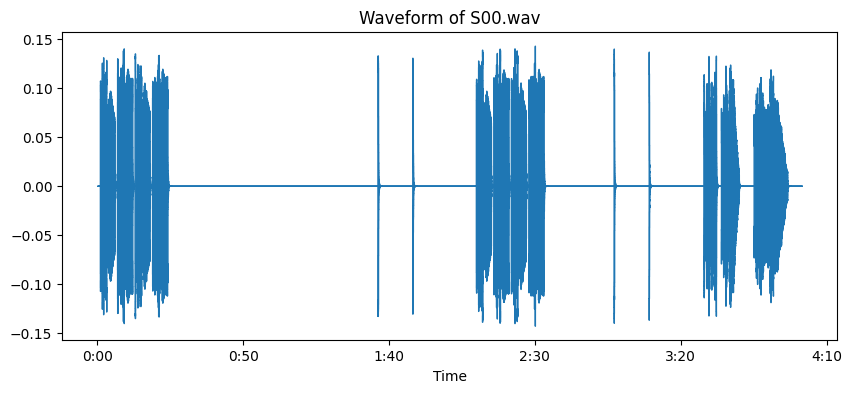

In [22]:
# Для начала импортируем необходимые библиотеки
import os
import pretty_midi
import librosa
import librosa.display
import matplotlib.pyplot as plt
import IPython.display as ipd

# Определим базовую статистику по датасету и одному из треков
dataset_path = '../babyslakh_16k'

# Подсчитаем общее количество треков
total_tracks = len([name for name in os.listdir(dataset_path) if os.path.isdir(os.path.join(dataset_path, name))])
print(f"Total tracks: {total_tracks}")

# Рассмотрим один трек
track_path = os.path.join(dataset_path, 'Track00001')
midi_path = os.path.join(track_path, 'MIDI')
stem_path = os.path.join(track_path, 'stems')

# Подсчитаем количество инструментов (MIDI файлов) в треке
total_instruments = len(os.listdir(midi_path))
print(f"Total instruments in Track00001: {total_instruments}")

# Проанализируем MIDI файл одного из инструментов
midi_file = os.path.join(midi_path, 'S00.mid')
midi_data = pretty_midi.PrettyMIDI(midi_file)

# Выведем некоторые ноты первого инструмента
print(f"Notes of instrument (S00.mid):")
for note in midi_data.instruments[0].notes[:10]:  # Выведем первые 10 нот
    print(f"Pitch: {note.pitch}, Start: {note.start}, End: {note.end}")

# Воспроизведем аудио первого стема (инструмента)
audio_file = os.path.join(stem_path, 'S00.wav')
audio_data, sr = librosa.load(audio_file, sr=None)

# Визуализируем волновую форму аудио
plt.figure(figsize=(10, 4))
librosa.display.waveshow(audio_data, sr=sr)
plt.title('Waveform of S00.wav')
plt.show()

# Для воспроизведения аудио в юпитер ноутбуке (закомментировано, чтобы избежать автоматического воспроизведения)
ipd.Audio(audio_file)


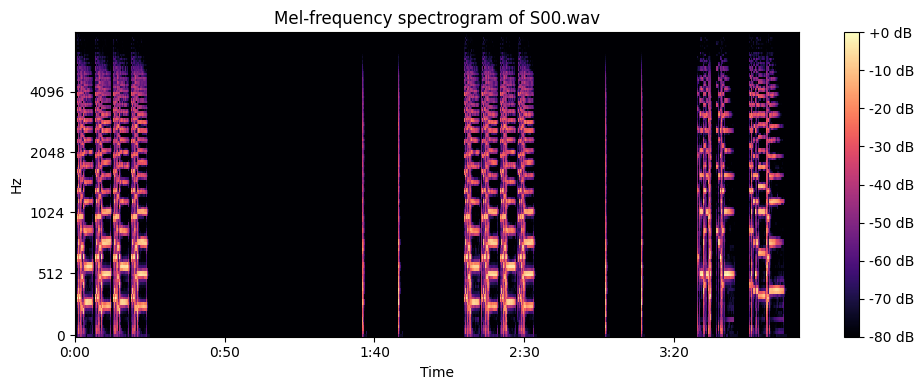

BPM: 80.01002792349975


In [21]:
#@title Plotting 3D-spcetrogram with GPT4
import numpy as np

# Визуализация мел-спектрограммы
S = librosa.feature.melspectrogram(y=audio_data, sr=sr)
S_dB = librosa.power_to_db(S, ref=np.max)

plt.figure(figsize=(10, 4))
librosa.display.specshow(S_dB, x_axis='time', y_axis='mel', sr=sr)
plt.colorbar(format='%+2.0f dB')
plt.title('Mel-frequency spectrogram of S00.wav')
plt.tight_layout()
plt.show()

# Извлечение BPM из MIDI файла
tempo_changes, tempi = midi_data.get_tempo_changes()
if len(tempi) > 0:
    bpm = tempi[0]  # Принимаем первый темп за основной BPM трека, если изменения темпа присутствуют
    print(f"BPM: {bpm}")
else:
    print("BPM information is not available in the MIDI file.")


## DEMUCS 

In [23]:
!python3 -m pip install -U git+https://github.com/facebookresearch/demucs#egg=demucs

Defaulting to user installation because normal site-packages is not writeable
  Cloning https://github.com/facebookresearch/demucs to /private/var/folders/cs/f4s9gb7x0h51dqc6ft18mnt80000gn/T/pip-install-em_z9h5r/demucs_5aa38808c2da4f49b47c901290d2b15f
  Running command git clone --filter=blob:none --quiet https://github.com/facebookresearch/demucs /private/var/folders/cs/f4s9gb7x0h51dqc6ft18mnt80000gn/T/pip-install-em_z9h5r/demucs_5aa38808c2da4f49b47c901290d2b15f
  Resolved https://github.com/facebookresearch/demucs to commit e976d93ecc3865e5757426930257e200846a520a
  Preparing metadata (setup.py) ... done
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 87.1/87.1 kB 1.2 MB/s eta 0:00:00a 0:00:01
  Installing build dependencies ... done
  Getting requirements to build wheel ... done
  Installing backend dependencies ... done
  Preparing metadata (pyproject.toml) ... done
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 59.6/59.6 kB 2.9 MB/s eta 0:00:00
  Preparing metadata (setup.py) ... don

In [36]:
!ls ../code/separated/htdemucs/

wait for me intro piano E minor


In [32]:
!python3 -m demucs -d cpu "../../tracks/wait for me intro piano E minor.mp3"

Downloading: "https://dl.fbaipublicfiles.com/demucs/hybrid_transformer/955717e8-8726e21a.th" to /Users/dsprotasov/.cache/torch/hub/checkpoints/955717e8-8726e21a.th
100%|██████████████████████████████████████| 80.2M/80.2M [00:10<00:00, 8.22MB/s]
Selected model is a bag of 1 models. You will see that many progress bars per track.
Separated tracks will be stored in /Users/dsprotasov/MusicNIR/MusicNIR/code/separated/htdemucs
Separating track ../../tracks/wait for me intro piano E minor.mp3
100%|██████████████████████████████████████████████████████████████████████████| 58.5/58.5 [00:29<00:00,  2.00seconds/s]


## CQT

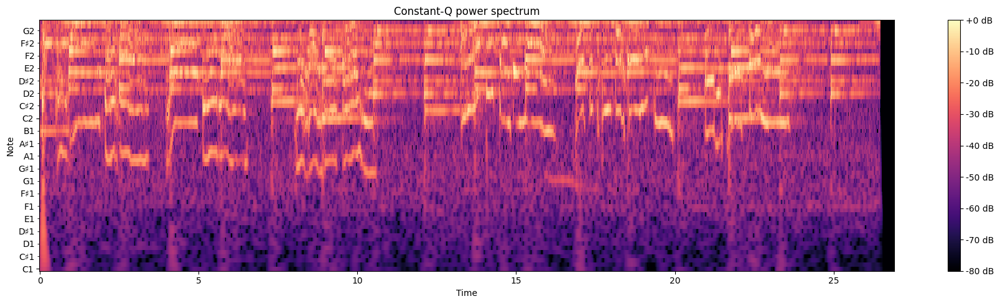

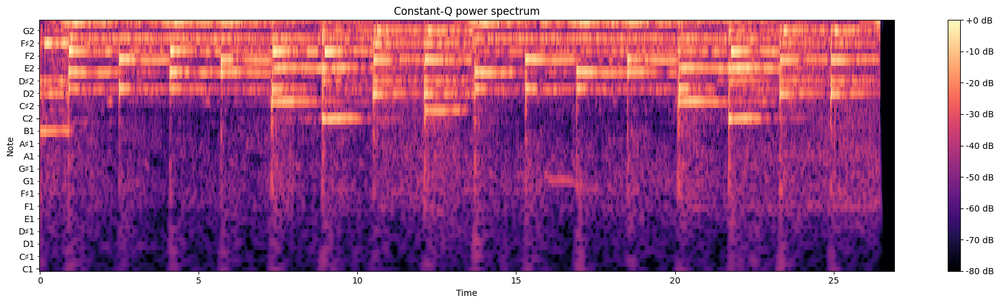

In [61]:
import librosa
import librosa.display
import numpy as np
import matplotlib.pyplot as plt

def plot_cqt(audio_path, name='Constant-Q power spectrum', start_time=28, end_time=10 ** 6, fmin='C3', fmax='C4'):
    y, sr = librosa.load(audio_path)

    start_sample = librosa.time_to_samples(start_time, sr=sr)
    end_sample = librosa.time_to_samples(end_time, sr=sr)
    y = y[start_sample:end_sample]

    # Выполнение CQT
    C = librosa.cqt(y, sr=sr, n_bins=60)
    C_dB = librosa.amplitude_to_db(abs(C), ref=np.max)

    # Визуализация CQT
    plt.figure(figsize=(18, 5))
    librosa.display.specshow(C_dB, sr=sr, x_axis='time', y_axis='cqt_note', bins_per_octave=12*3)
    plt.colorbar(format='%+2.0f dB')
    plt.title(name)
    plt.tight_layout()
    plt.show()

plot_cqt('../../tracks/wait for me intro piano E minor.mp3')
plot_cqt('../code/separated/htdemucs/wait for me intro piano E minor/other.wav')

### CQT_example_plot

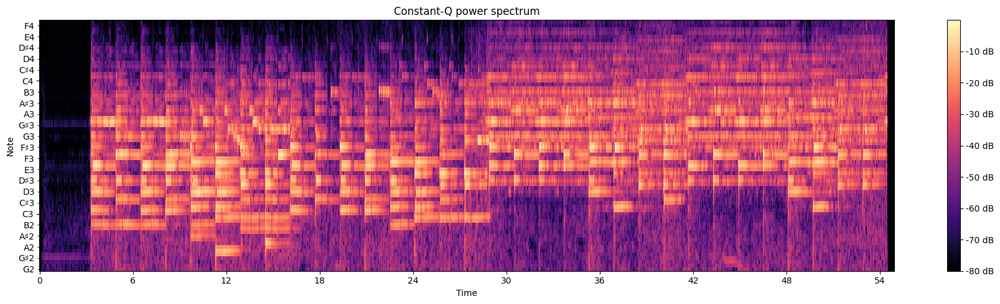

In [50]:

plot_cqt('../code/separated/htdemucs/wait for me intro piano E minor/other.wav', start_time=0)

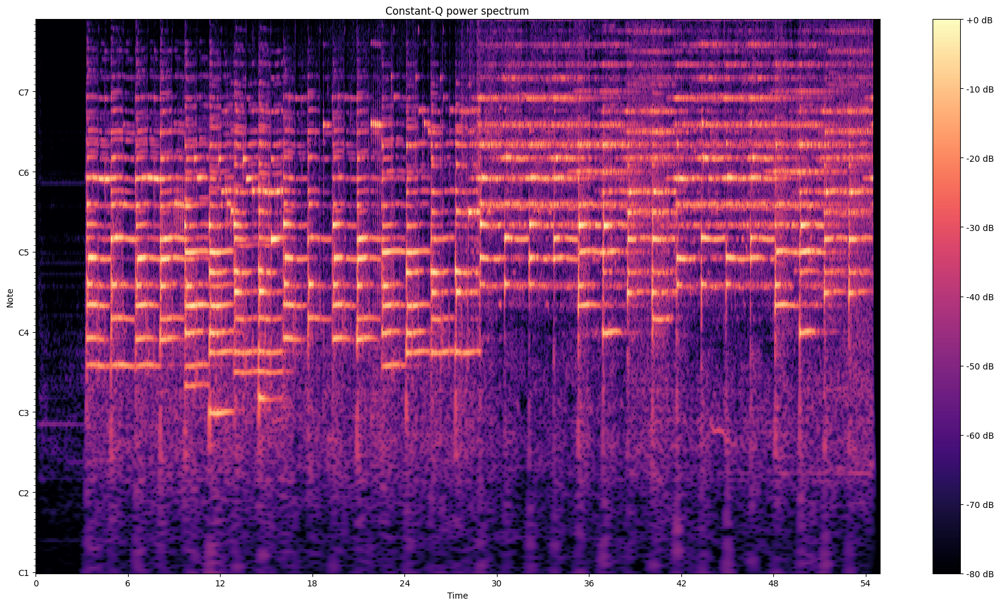

In [99]:
import librosa
import librosa.display
import matplotlib.pyplot as plt
import numpy as np

def plot_cqt(audio_path, name='Constant-Q power spectrum', start_time=None, end_time=None, fmin='C1', fmax='B7'):
    y, sr = librosa.load(audio_path)

    # Если start_time и end_time не указаны, используем весь трек
    if start_time is not None and end_time is not None:
        start_sample = librosa.time_to_samples(start_time, sr=sr)
        end_sample = librosa.time_to_samples(end_time, sr=sr)
        y = y[start_sample:end_sample]

    # Расчёт количества бинов
    fmin_hz = librosa.note_to_hz(fmin)
    fmax_hz = librosa.note_to_hz(fmax)
    n_bins = 3  * int(librosa.note_to_midi(fmax) - librosa.note_to_midi(fmin))

    # Выполнение CQT
    C = librosa.cqt(y, sr=sr, fmin=fmin_hz, n_bins=n_bins, bins_per_octave=12*3)
    C_dB = librosa.amplitude_to_db(abs(C), ref=np.max)

    # Визуализация CQT
    plt.figure(figsize=(18, 10))
    librosa.display.specshow(C_dB, sr=sr, x_axis='time', y_axis='cqt_note', fmin=fmin_hz, bins_per_octave=12*3)
    plt.colorbar(format='%+2.0f dB')
    plt.title(name)
    plt.tight_layout()
    plt.show()

# Пример вызова функции

plot_cqt(
    '../code/separated/htdemucs/wait for me intro piano E minor/other.wav',
)

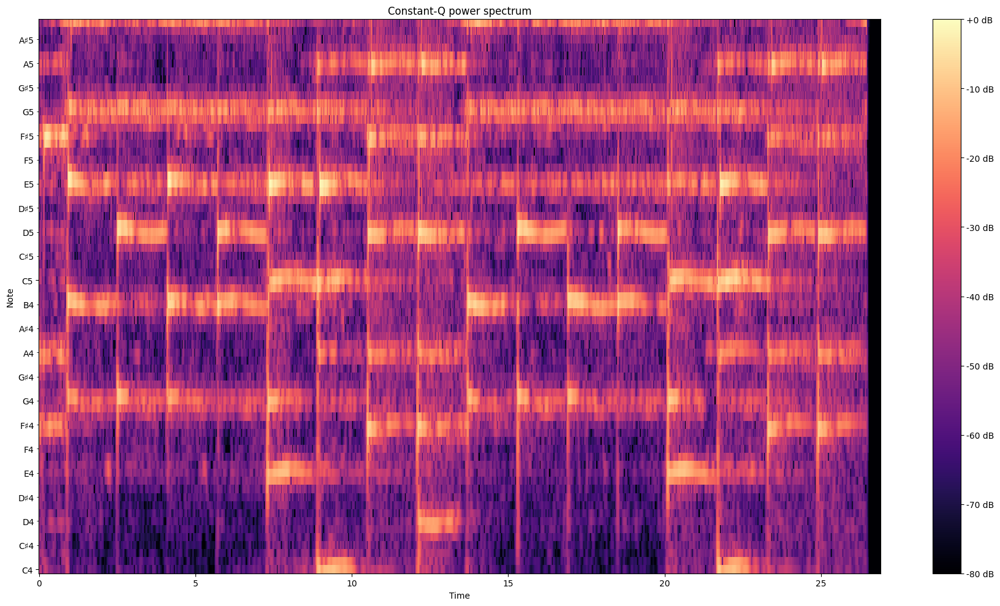

In [102]:
plot_cqt(
    '../code/separated/htdemucs/wait for me intro piano E minor/other.wav',
    fmin='C4', fmax='B5', start_time=28, end_time=55
)

## BabySlakh Inference
 - BabySlakh берём любой инсрумент
 - Прогоняем через BasicPitch
 -  Считаем Accuracy относительно mid файла

   

In [109]:
# Этап первый, проходимся по BabySlakh и получаем предсказания basic_pitch
os.listdir('../datasets/babyslakh_16k/Track00006')

['stems', 'MIDI', 'metadata.yaml', 'mix.wav', 'all_src.mid']

In [197]:
import pretty_midi
import numpy as np
import matplotlib.pyplot as plt

def load_midi_notes(midi_file):
    midi_data = pretty_midi.PrettyMIDI(midi_file)
    notes = []
    for instrument in midi_data.instruments:
        for note in instrument.notes:
            notes.append((note.start, note.end, note.pitch))
    return notes

def calculate_metrics(predicted_notes, target_notes):
    # Реализуйте функцию расчёта Precision, Recall и F1 Score
    # Это может включать создание матрицы расстояний между нотами и выбор наилучших соответствий
    pass

def plot_piano_roll_two(predicted_midi, target_midi):
    fig, ax = plt.subplots(nrows=2, ncols=1, figsize=(12, 8))
    
    # Загрузка MIDI файлов
    predicted_data = pretty_midi.PrettyMIDI(predicted_midi)
    target_data = pretty_midi.PrettyMIDI(target_midi)
    
    # Генерация piano-roll
    for i, midi_data in enumerate([predicted_data, target_data]):
        piano_roll = midi_data.get_piano_roll(fs=100)
        ax[i].imshow(piano_roll, aspect='auto', origin='lower', interpolation='nearest')
        ax[i].set_title('Predicted' if i == 0 else 'Target')
    
    plt.tight_layout()
    plt.show()

# Пример использования
# predicted_midi = 'path_to_predicted_midi.mid'
# target_midi = 'path_to_target_midi.mid'
# predicted_notes = load_midi_notes(predicted_midi)
# target_notes = load_midi_notes(target_midi)

# metrics = calculate_metrics(predicted_notes, target_notes)
# plot_piano_roll(predicted_midi, target_midi)


In [303]:
# Этап второй, пишем функции метрик и сравниваем
import mir_eval
import pretty_midi

def midi_to_mir_eval_format(midi_data):
    """Преобразование MIDI файла в формат для mir_eval."""
    # midi_data = pretty_midi.PrettyMIDI(midi_path)
    notes = []
    for instrument in midi_data.instruments:
        for note in instrument.notes:
            # mir_eval работает с временем в секундах, pretty_midi возвращает время в секундах
            start = note.start
            end = note.end
            pitch = note.pitch
            notes.append((start, end, pitch))
    return notes

def mir_eval_format_to_midi(note_events, instrument_name='Acoustic Grand Piano'):
    """
    Convert a list of note events to a PrettyMIDI object.
    
    Parameters:
        note_events (list of tuples): List of note events, where each event is a tuple (start_time, end_time, pitch).
        instrument_name (str): The name of the instrument to use for these notes.
    
    Returns:
        pretty_midi.PrettyMIDI: The PrettyMIDI object created from the note events.
    """
    # Create a new PrettyMIDI object
    midi_data = pretty_midi.PrettyMIDI()

    # Create a new Instrument instance (using a piano program number: 0)
    program = pretty_midi.instrument_name_to_program(instrument_name)
    instrument = pretty_midi.Instrument(program=program)

    # Add notes to the instrument
    for start, end, pitch in note_events:
        # Create a Note instance for each note event
        note = pretty_midi.Note(
            velocity=100,  # Setting a default velocity
            pitch=pitch,
            start=start,
            end=end
        )
        instrument.notes.append(note)

    # Add the instrument to the PrettyMIDI object
    midi_data.instruments.append(instrument)

    return midi_data

# # Example usage
# note_events = [
#     (0.5, 1.0, 60),  # C4
#     (1.5, 2.0, 64),  # E4
#     (2.5, 3.0, 67)   # G4
# ]
# midi_file = mir_eval_format_to_midi(note_events)

# # Optionally, save the PrettyMIDI object to a MIDI file
# # midi


def calculate_Fno(predicted_midi, target_midi):
    """Расчет F-measure-no-offset (Fno) между предсказанным и целевым MIDI."""
    
    # Конвертируем MIDI в формат, подходящий для mir_eval
    predicted_notes = midi_to_mir_eval_format(predicted_midi)
    target_notes = midi_to_mir_eval_format(target_midi)

    if len(predicted_notes) == 0:
        return 0
    
    # mir_eval требует разделения данных на onset, offset и pitches
    predicted_onsets, predicted_offsets, predicted_pitches = zip(*predicted_notes)
    target_onsets, target_offsets, target_pitches = zip(*target_notes)

    predicted_intervals = np.vstack((predicted_onsets, predicted_offsets)).T
    target_intervals = np.vstack((target_onsets, target_offsets)).T
    
    # Вычисляем Precision, Recall и F-measure
    # Важно: mir_eval принимает дополнительные параметры для вычисления, например window для сравнения onset
    precision, recall, f_measure, _ = mir_eval.transcription.precision_recall_f1_overlap(
        target_intervals,  # Интервалы целевых нот
        np.array(target_pitches),  # Частоты целевых нот
        predicted_intervals,  # Интервалы предсказанных нот
        np.array(predicted_pitches),  # Частоты предсказанных нот
        onset_tolerance=0.05,  # Допуск 50 мс для начала ноты
        pitch_tolerance=50,  # Допуск четверти тона (50 центов)
        offset_ratio=None  # Игнорирование окончания ноты
    )
    
    return f_measure

# Пример вызова
# predicted_midi_path = 'path_to_predicted_midi.mid'
# target_midi_path = 'path_to_target_midi.mid'
# f_no = calculate_Fno(predicted_midi_path, target_midi_path)
# print(f"F-measure-no-offset (Fno): {f_no}")


Processing Track00006...
Predicting MIDI for ../datasets/babyslakh_16k/Track00006/stems/S01.wav...

Визуализация целевого MIDI:


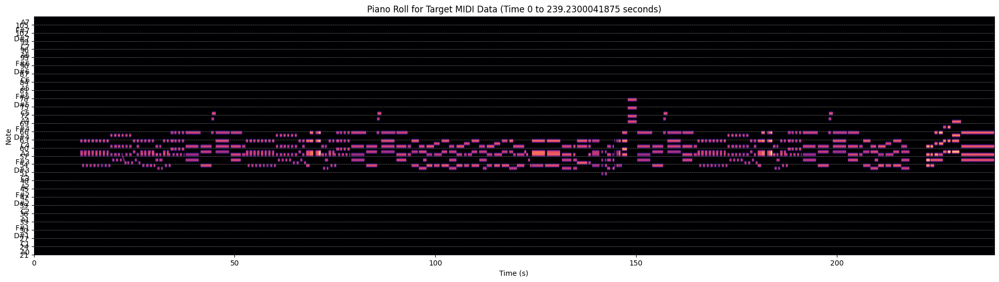


Визуализация предсказанного MIDI:


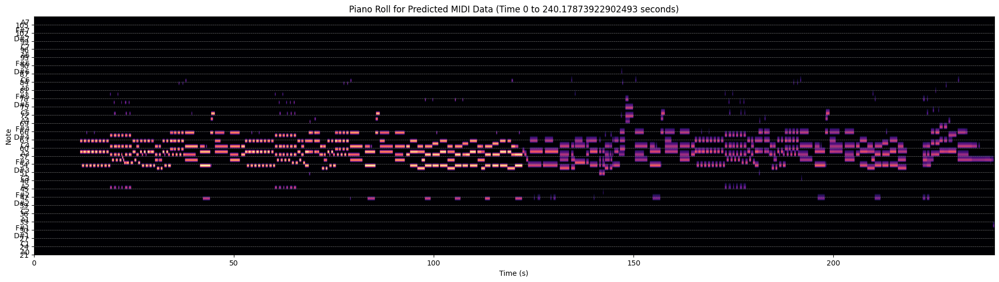


Рассчитанная метрика F-measure-no-offset (Fno) для сравнения предсказанного и целевого MIDI: 0.8095


In [200]:
import os
import pretty_midi
import mir_eval
from basic_pitch.inference import predict
from basic_pitch import ICASSP_2022_MODEL_PATH

# Путь к датасету BabySlakh
dataset_path = '../datasets/babyslakh_16k'

# Для дебага используем только первый трек
DEBUG_MODE = True

def process_track(track_path):
    # Пути к аудио и MIDI файлам
    audio_path = os.path.join(track_path, 'stems', 'S01.wav')
    midi_target_path = os.path.join(track_path, 'MIDI', 'S01.mid')
    
    # Получение предсказаний от модели
    model_output, predicted_midi, note_events = predict(
        audio_path,
        # minimum_frequency=20,  # Нижняя граница частоты
        # maximum_frequency=4000  # Верхняя граница частоты
    )
    
    # Загрузка таргета MIDI для сравнения
    target_midi = pretty_midi.PrettyMIDI(midi_target_path)
    
    # Вызываем функцию для расчёта метрик и визуализации (определите её самостоятельно)
    visualize(predicted_midi, target_midi)

    # Расчёт метрики Fno и её вывод
    f_no = calculate_Fno(predicted_midi, target_midi)
    print(f"\nРассчитанная метрика F-measure-no-offset (Fno) для сравнения предсказанного и целевого MIDI: {f_no:.4f}")


def visualize(predicted_midi, target_midi):
    """
    Функция для визуализации результатов сравнения
    предсказанного и целевого MIDI файлов.
    
    Args:
    predicted_midi_path (str): Путь к предсказанному MIDI файлу.
    target_midi_path (str): Путь к целевому MIDI файлу.
    """
    print("\nВизуализация целевого MIDI:")
    plot_piano_roll(target_midi, name="Target")

    print("\nВизуализация предсказанного MIDI:")
    plot_piano_roll(predicted_midi, name="Predicted")
    
    

tracks = os.listdir(dataset_path)
DEBUG_MODE = True
for track in tracks:
    if track.startswith('Track'):
        print(f"Processing {track}...")
        process_track(os.path.join(dataset_path, track))
        if DEBUG_MODE:
            break  # Выход после обработки первого трека, если включен дебаг-режим
        print("\n" * 10)


Processing Track00006...
Predicting MIDI for ../datasets/babyslakh_16k/Track00006/stems/S01.wav...

Визуализация целевого MIDI:


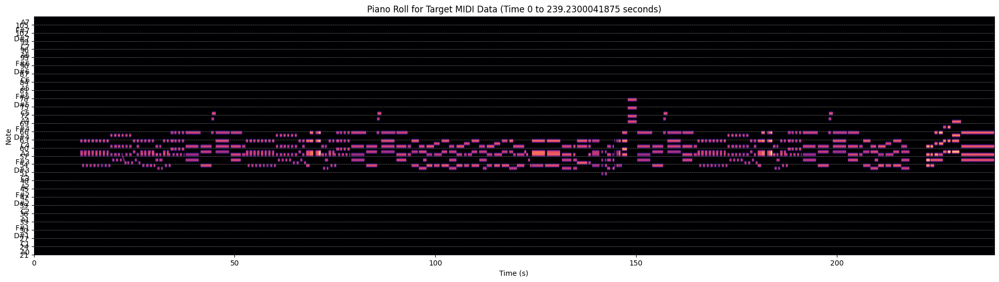


Визуализация предсказанного MIDI:


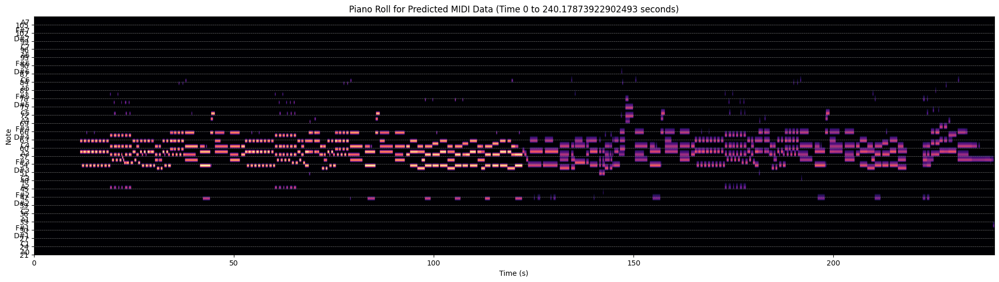


Рассчитанная метрика F-measure-no-offset (Fno) для сравнения предсказанного и целевого MIDI: 0.8095











Processing Track00001...
Predicting MIDI for ../datasets/babyslakh_16k/Track00001/stems/S01.wav...

Визуализация целевого MIDI:


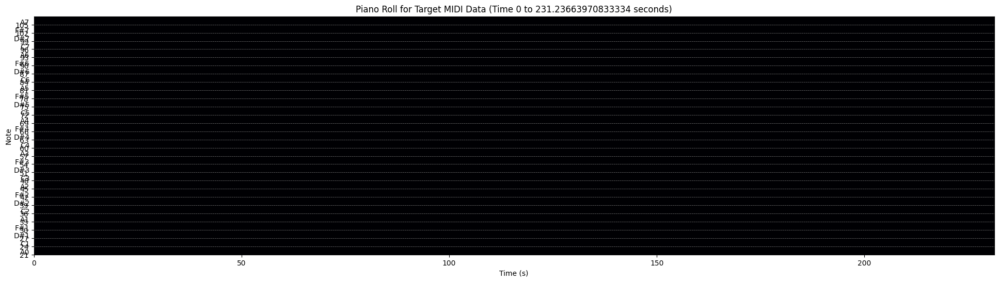


Визуализация предсказанного MIDI:


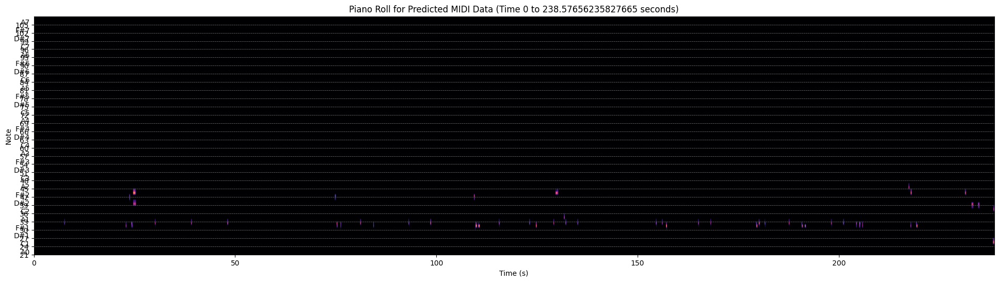


Рассчитанная метрика F-measure-no-offset (Fno) для сравнения предсказанного и целевого MIDI: 0.0035











Processing Track00008...
Predicting MIDI for ../datasets/babyslakh_16k/Track00008/stems/S01.wav...

Визуализация целевого MIDI:


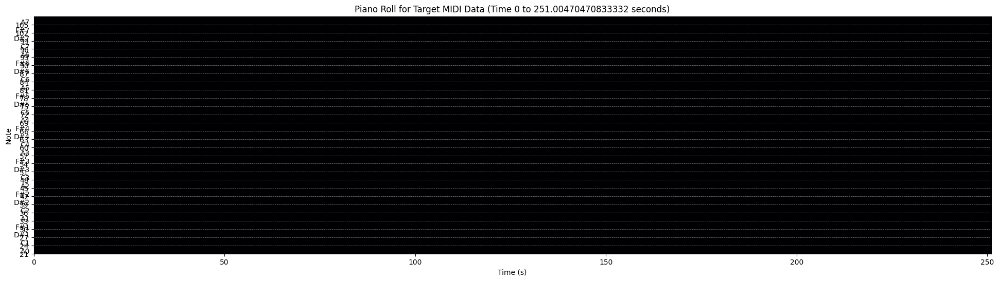


Визуализация предсказанного MIDI:


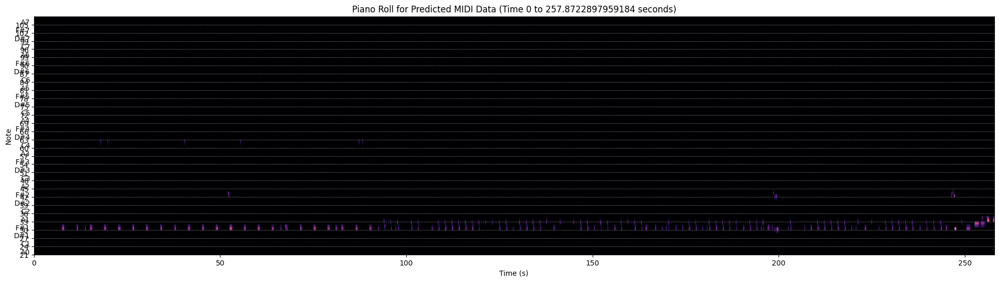


Рассчитанная метрика F-measure-no-offset (Fno) для сравнения предсказанного и целевого MIDI: 0.0008











Processing Track00009...
Predicting MIDI for ../datasets/babyslakh_16k/Track00009/stems/S01.wav...

Визуализация целевого MIDI:


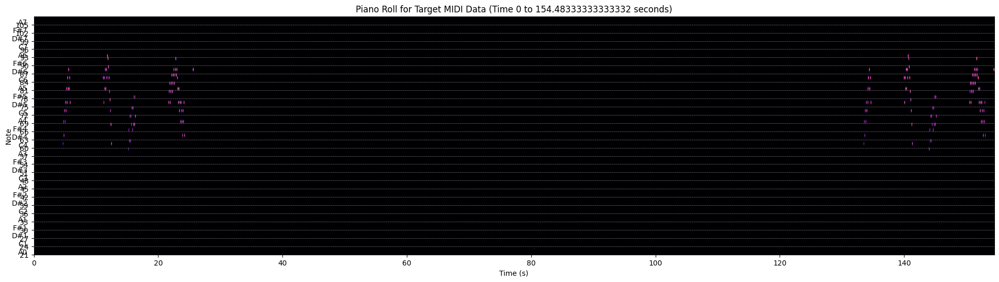


Визуализация предсказанного MIDI:


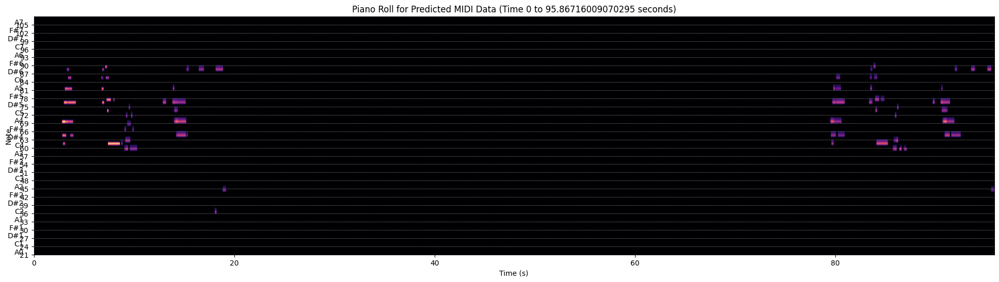


Рассчитанная метрика F-measure-no-offset (Fno) для сравнения предсказанного и целевого MIDI: 0.5333











Processing Track00007...
Predicting MIDI for ../datasets/babyslakh_16k/Track00007/stems/S01.wav...

Визуализация целевого MIDI:


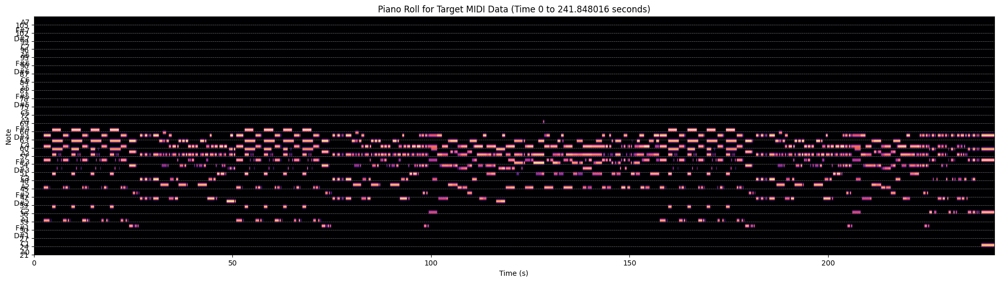


Визуализация предсказанного MIDI:


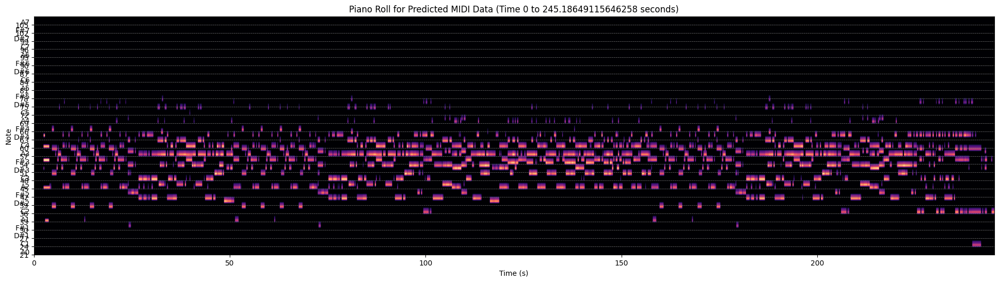


Рассчитанная метрика F-measure-no-offset (Fno) для сравнения предсказанного и целевого MIDI: 0.7882











Processing Track00014...
Predicting MIDI for ../datasets/babyslakh_16k/Track00014/stems/S01.wav...

Визуализация целевого MIDI:


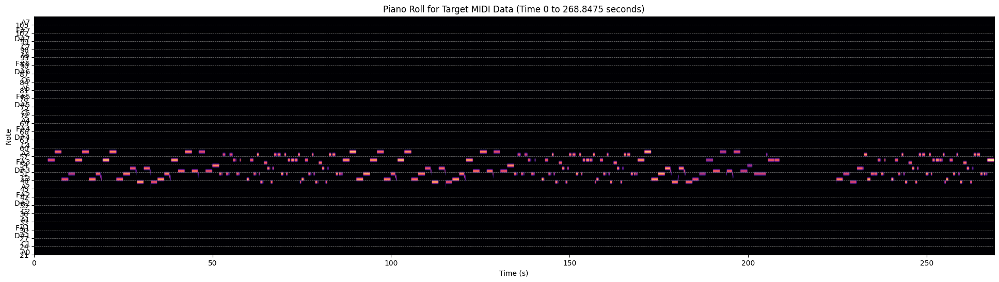


Визуализация предсказанного MIDI:


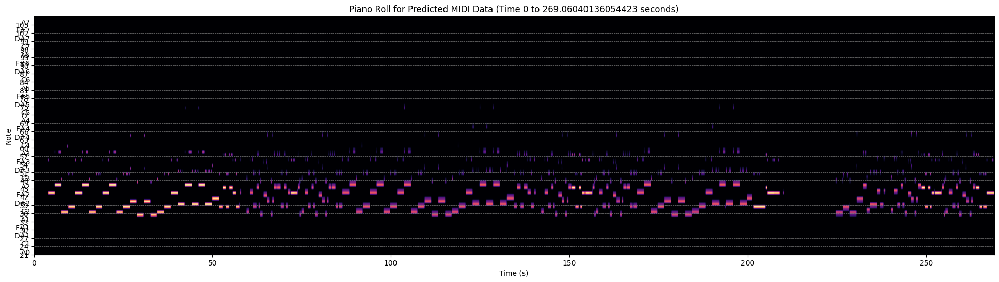


Рассчитанная метрика F-measure-no-offset (Fno) для сравнения предсказанного и целевого MIDI: 0.4675











Processing Track00013...
Predicting MIDI for ../datasets/babyslakh_16k/Track00013/stems/S01.wav...

Визуализация целевого MIDI:


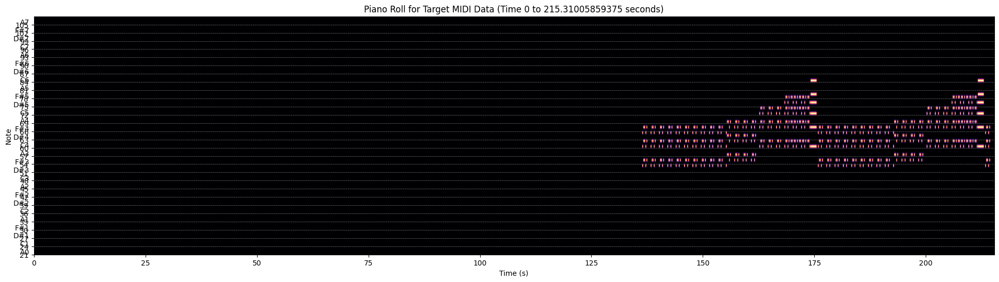


Визуализация предсказанного MIDI:


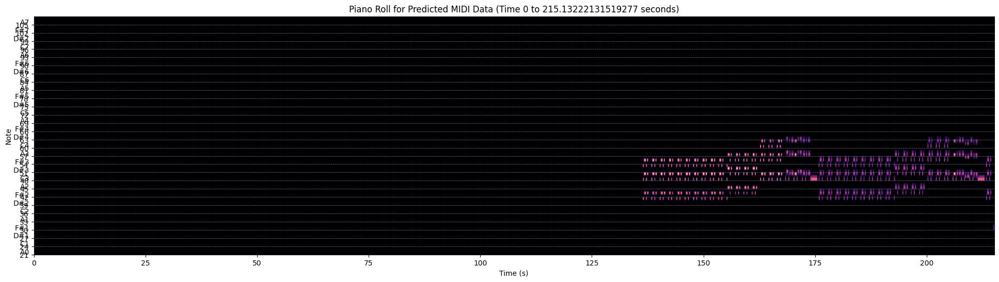


Рассчитанная метрика F-measure-no-offset (Fno) для сравнения предсказанного и целевого MIDI: 0.3007











Processing Track00012...
Predicting MIDI for ../datasets/babyslakh_16k/Track00012/stems/S01.wav...

Визуализация целевого MIDI:


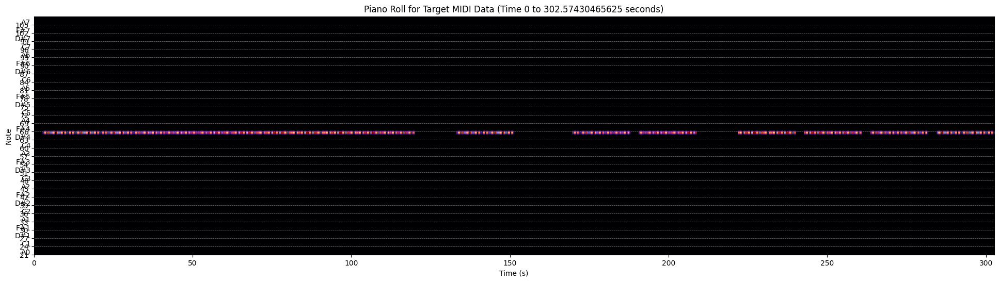


Визуализация предсказанного MIDI:


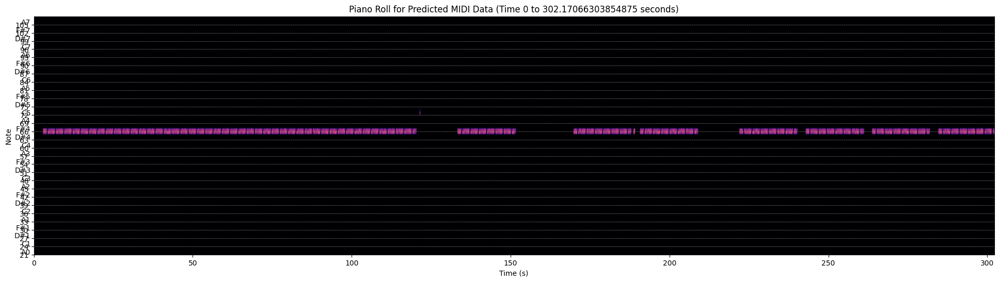


Рассчитанная метрика F-measure-no-offset (Fno) для сравнения предсказанного и целевого MIDI: 0.6823











Processing Track00015...
Predicting MIDI for ../datasets/babyslakh_16k/Track00015/stems/S01.wav...

Визуализация целевого MIDI:


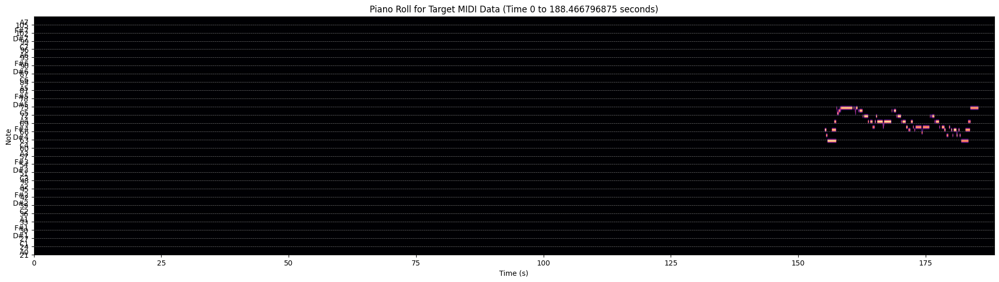


Визуализация предсказанного MIDI:


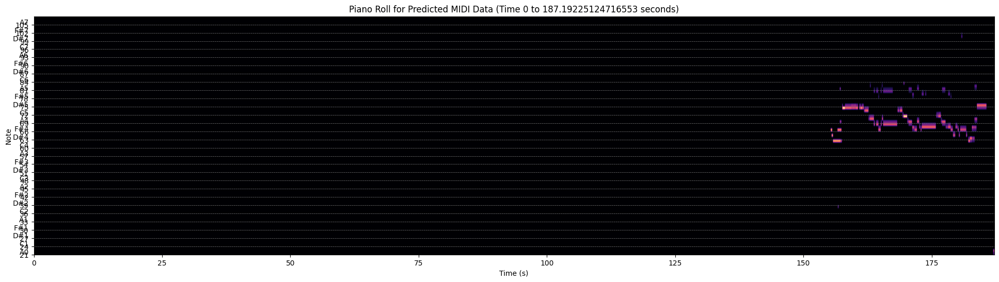


Рассчитанная метрика F-measure-no-offset (Fno) для сравнения предсказанного и целевого MIDI: 0.7442











Processing Track00002...
Predicting MIDI for ../datasets/babyslakh_16k/Track00002/stems/S01.wav...

Визуализация целевого MIDI:


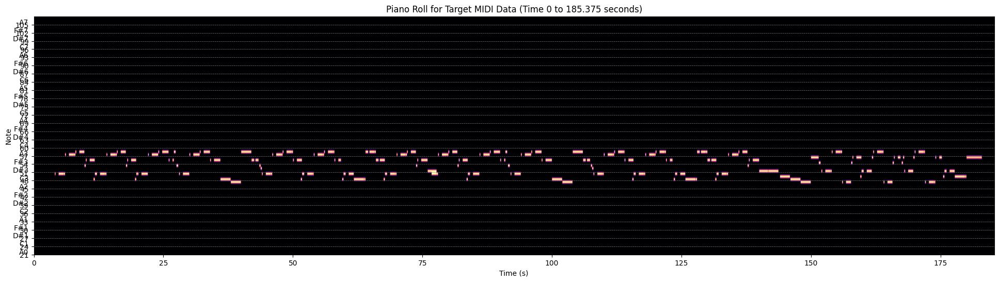


Визуализация предсказанного MIDI:


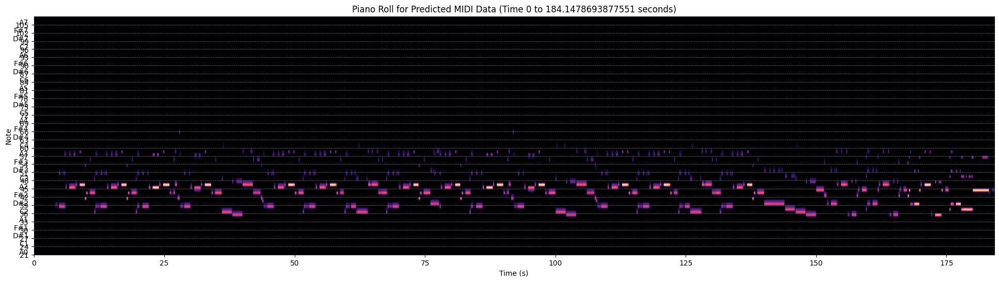


Рассчитанная метрика F-measure-no-offset (Fno) для сравнения предсказанного и целевого MIDI: 0.4330











Processing Track00005...
Predicting MIDI for ../datasets/babyslakh_16k/Track00005/stems/S01.wav...

Визуализация целевого MIDI:


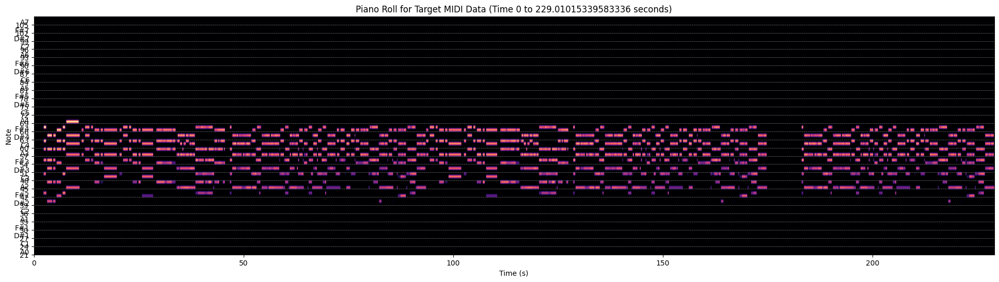


Визуализация предсказанного MIDI:


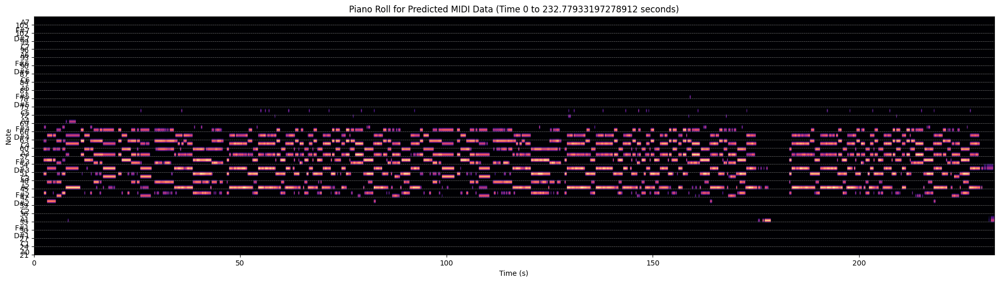


Рассчитанная метрика F-measure-no-offset (Fno) для сравнения предсказанного и целевого MIDI: 0.8044











Processing Track00004...
Predicting MIDI for ../datasets/babyslakh_16k/Track00004/stems/S01.wav...

Визуализация целевого MIDI:


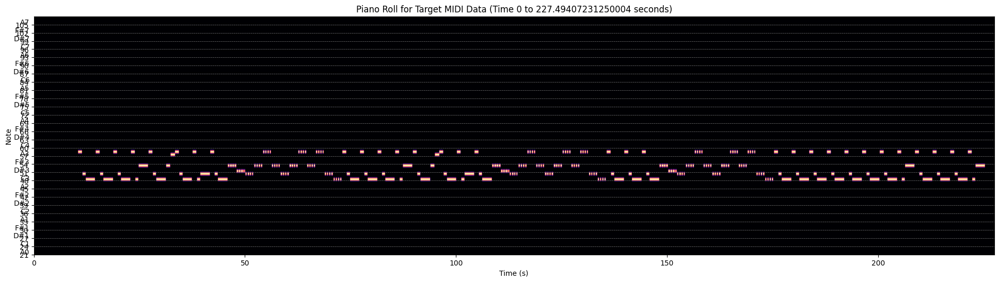


Визуализация предсказанного MIDI:


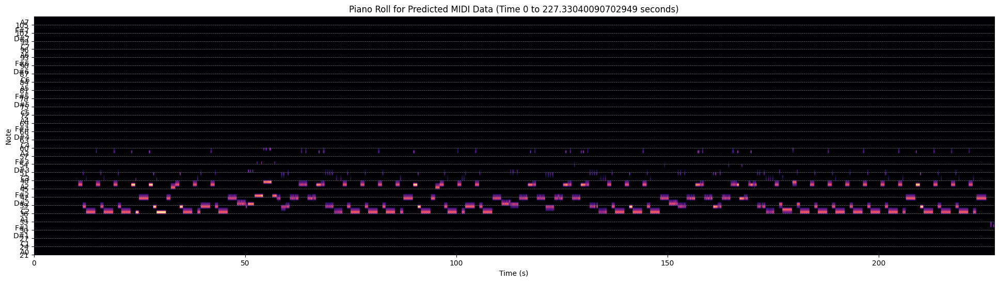


Рассчитанная метрика F-measure-no-offset (Fno) для сравнения предсказанного и целевого MIDI: 0.3535











Processing Track00003...
Predicting MIDI for ../datasets/babyslakh_16k/Track00003/stems/S01.wav...

Визуализация целевого MIDI:


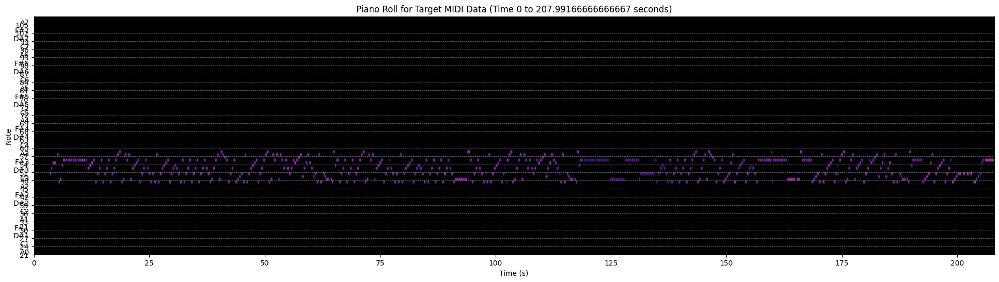


Визуализация предсказанного MIDI:


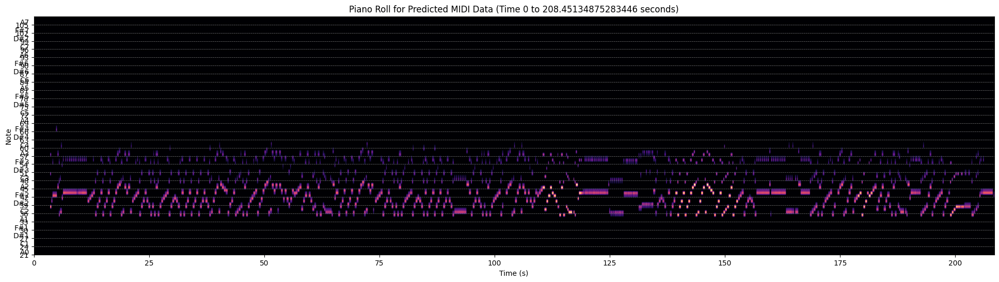


Рассчитанная метрика F-measure-no-offset (Fno) для сравнения предсказанного и целевого MIDI: 0.5085











Processing Track00019...
Predicting MIDI for ../datasets/babyslakh_16k/Track00019/stems/S01.wav...

Визуализация целевого MIDI:


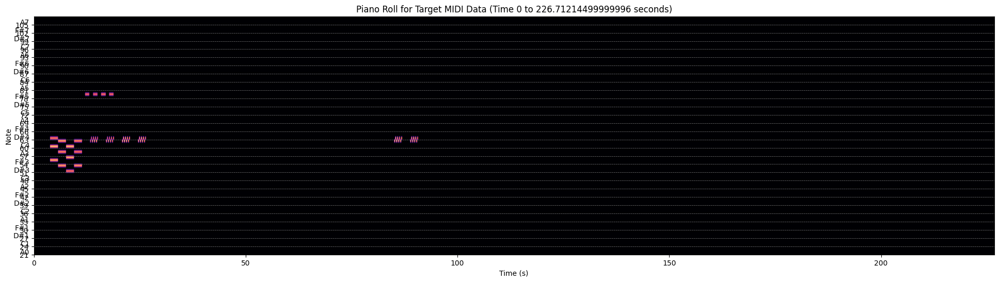


Визуализация предсказанного MIDI:


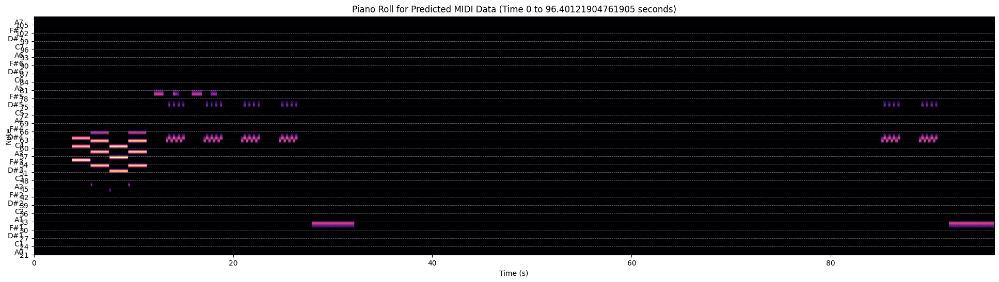


Рассчитанная метрика F-measure-no-offset (Fno) для сравнения предсказанного и целевого MIDI: 0.7950











Processing Track00010...
Predicting MIDI for ../datasets/babyslakh_16k/Track00010/stems/S01.wav...

Визуализация целевого MIDI:


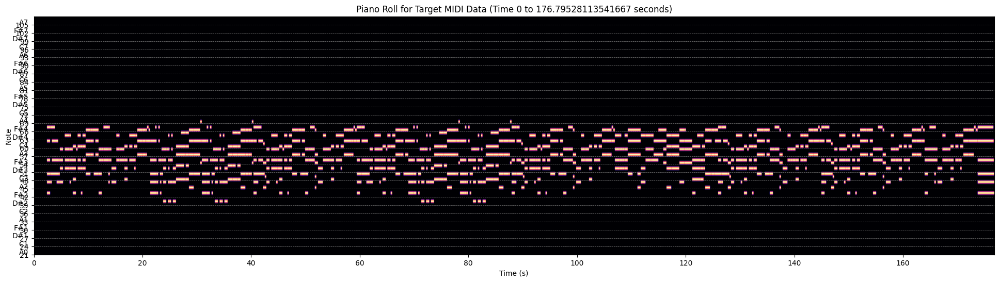


Визуализация предсказанного MIDI:


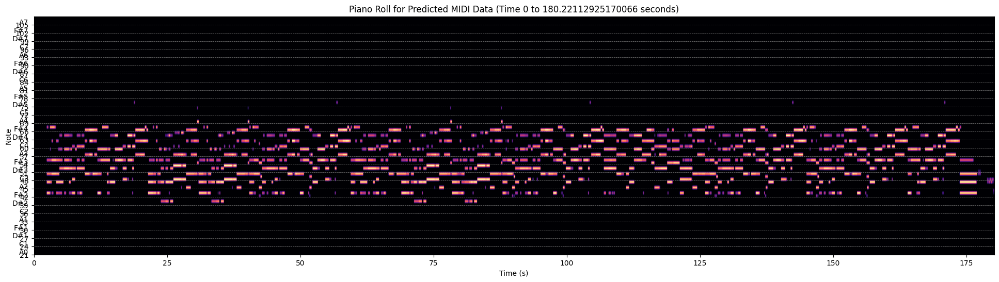


Рассчитанная метрика F-measure-no-offset (Fno) для сравнения предсказанного и целевого MIDI: 0.8765











Processing Track00017...
Predicting MIDI for ../datasets/babyslakh_16k/Track00017/stems/S01.wav...

Визуализация целевого MIDI:


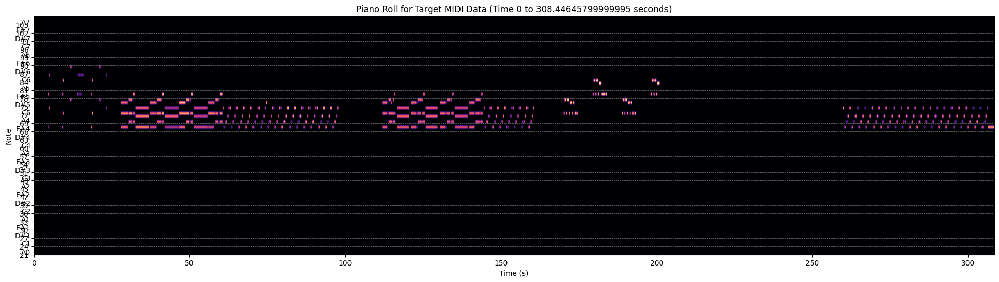


Визуализация предсказанного MIDI:


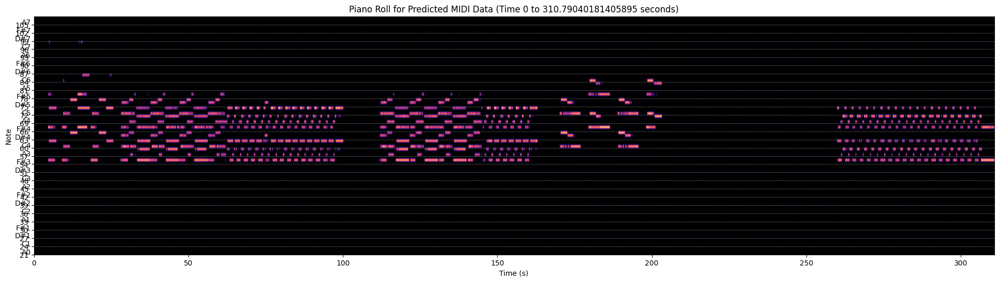


Рассчитанная метрика F-measure-no-offset (Fno) для сравнения предсказанного и целевого MIDI: 0.1466











Processing Track00016...
Predicting MIDI for ../datasets/babyslakh_16k/Track00016/stems/S01.wav...

Визуализация целевого MIDI:


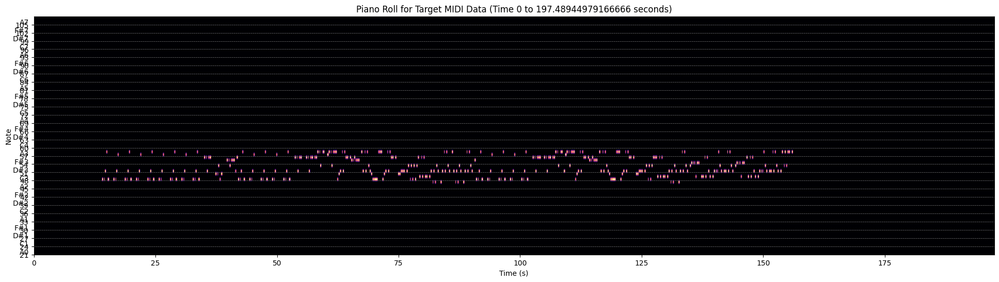


Визуализация предсказанного MIDI:


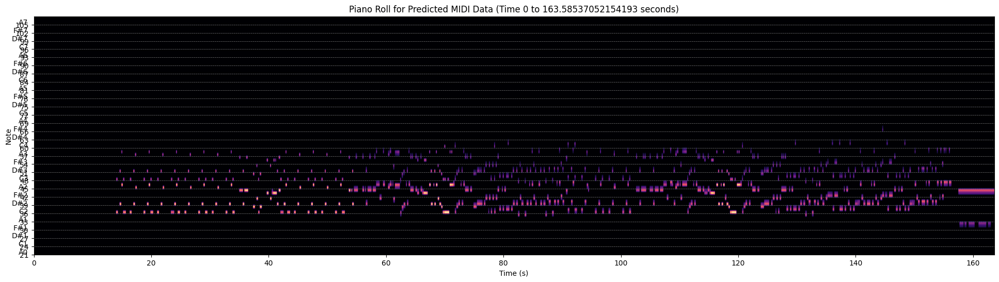


Рассчитанная метрика F-measure-no-offset (Fno) для сравнения предсказанного и целевого MIDI: 0.5574











Processing Track00011...
Predicting MIDI for ../datasets/babyslakh_16k/Track00011/stems/S01.wav...

Визуализация целевого MIDI:


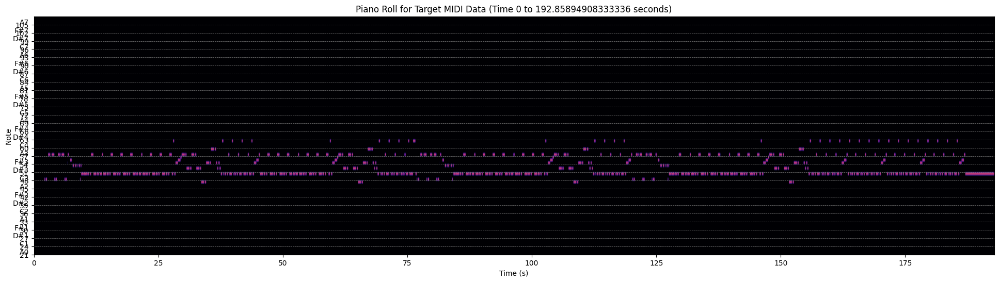


Визуализация предсказанного MIDI:


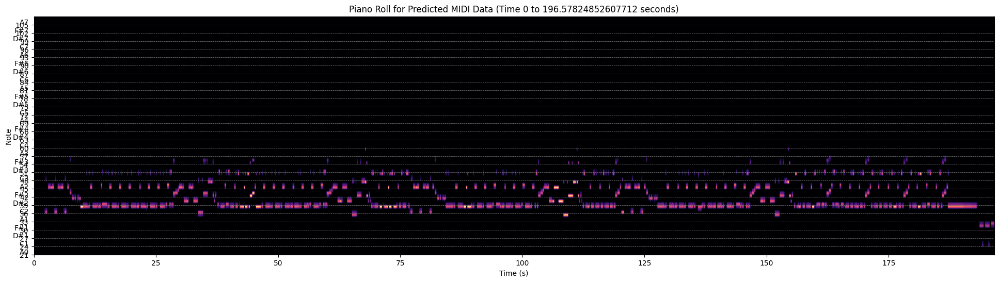


Рассчитанная метрика F-measure-no-offset (Fno) для сравнения предсказанного и целевого MIDI: 0.2667











Processing Track00018...
Predicting MIDI for ../datasets/babyslakh_16k/Track00018/stems/S01.wav...

Визуализация целевого MIDI:


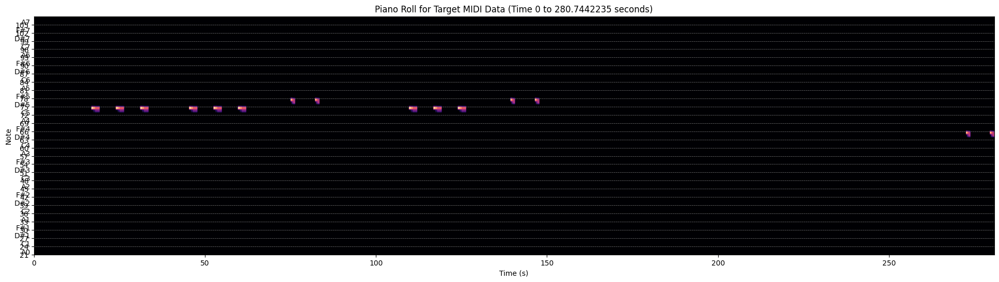


Визуализация предсказанного MIDI:


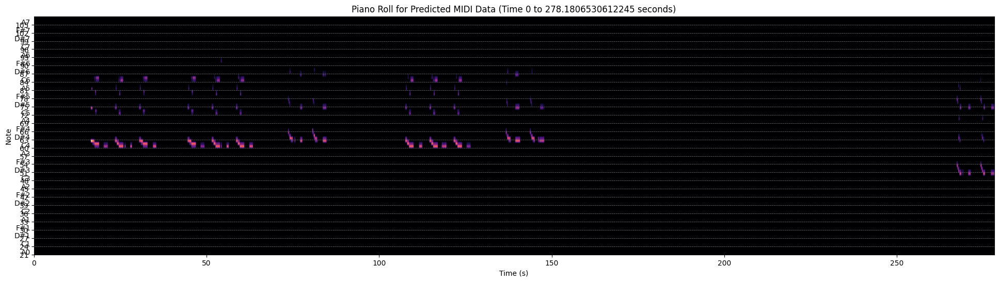


Рассчитанная метрика F-measure-no-offset (Fno) для сравнения предсказанного и целевого MIDI: 0.0943











Processing Track00020...
Predicting MIDI for ../datasets/babyslakh_16k/Track00020/stems/S01.wav...

Визуализация целевого MIDI:


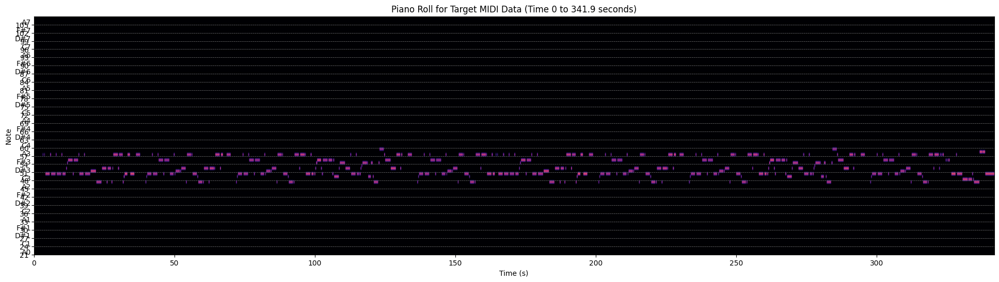


Визуализация предсказанного MIDI:


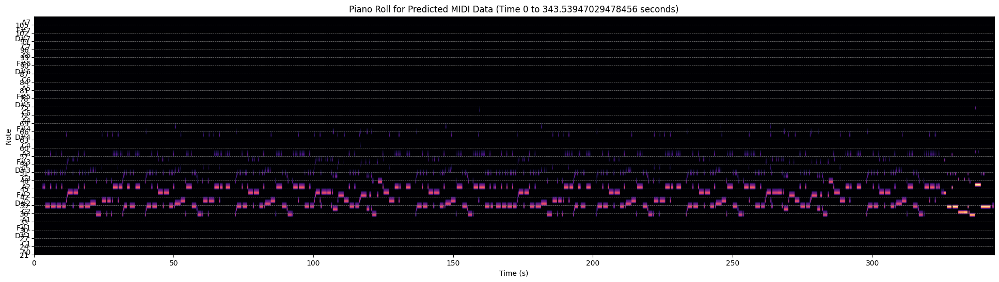


Рассчитанная метрика F-measure-no-offset (Fno) для сравнения предсказанного и целевого MIDI: 0.5004













In [136]:
tracks = os.listdir(dataset_path)
DEBUG_MODE = False
for track in tracks:
    if track.startswith('Track'):
        print(f"Processing {track}...")
        process_track(os.path.join(dataset_path, track))
        if DEBUG_MODE:
            break  # Выход после обработки первого трека, если включен дебаг-режим
        print("\n" * 10)


## BPM ESTIMATION

In [140]:
!ls ../../MusicNIR/tracks

#HABIBATI.mp3
Alan Walker - Faded.mp3
Coldplay — The Scientist.mp3
DEAD BLONDE - Мальчик на девятке.mp3
Ed Sheeran - Shape Of You.mp3
Grateful.mp3
Justin Bieber - What Do You Mean.mp3
Marshmello - Ritual ft Wrabel.mp3
Marshmello-Keep-It-Mello.mp3
Martin Garrix — Animals.mp3
Ne Angel.mp3
Numb.mp3
Yellow.mp3
alan-walker-fade.mp3
apologize.mp3
drippin so pretty- Lets Go Pt 2 (official music video).mp3
mxnarch - Nightwing.mp3
nothingnowhere-upside_down.mp3
pascal_letoublon_friendships.mp3
the_chainsmokers_feat_halsey_-_closer.mp3
youtube_links.json
АДЛИН, Килджо - Одна (MP3SUN.net).mp3
Адлин - Dead inside (Muzten.net).mp3
Демоны.mp3
ПОШЛАЯ МОЛЛИ - Контракт.mp3
ПОШЛАЯ МОЛЛИ - НОН СТОП.mp3
ПОШЛАЯ МОЛЛИ –СУПЕРМАРКЕТ  [320 kbps].mp3
Пошлая Молли – Типичная вечеринка с бассейном.mp3
Пошлая Молли, Элджей - Дом Периньон.mp3


In [282]:
import librosa


file_path = '../../MusicNIR/tracks/Ed Sheeran - Shape Of You.mp3'

def get_bpm(file_path):
    y, sr = librosa.load(file_path)
    
    # Estimate the tempo (BPM)
    tempo, _ = librosa.beat.beat_track(y=y, sr=sr)
    print(f'Estimated BPM: {tempo}')
    return tempo

folder = '../../MusicNIR/tracks/'
get_bpm(os.path.join(folder, 'Ed Sheeran - Shape Of You.mp3'))

Estimated BPM: 129.19921875


129.19921875

In [153]:
for track in os.listdir(folder):
    print(f'\nCurrent Track: {track}')
    get_bpm(os.path.join(folder, track))


Current Track: Justin Bieber - What Do You Mean.mp3
Estimated BPM: 123.046875

Current Track: alan-walker-fade.mp3
Estimated BPM: 89.10290948275862

Current Track: Адлин - Dead inside (Muzten.net).mp3
Estimated BPM: 129.19921875

Current Track: drippin so pretty- Lets Go Pt 2 (official music video).mp3


/var/folders/cs/f4s9gb7x0h51dqc6ft18mnt80000gn/T/ipykernel_53694/3667738667.py:7: UserWarning: PySoundFile failed. Trying audioread instead.
  y, sr = librosa.load(file_path)
[src/libmpg123/parse.c:skip_junk():1276] error: Giving up searching valid MPEG header after 65536 bytes of junk.


Estimated BPM: 151.99908088235293

Current Track: apologize.mp3
Estimated BPM: 117.45383522727273

Current Track: Демоны.mp3
Estimated BPM: 73.828125

Current Track: pascal_letoublon_friendships.mp3


[src/libmpg123/id3.c:process_comment():584] error: No comment text / valid description?


Estimated BPM: 117.45383522727273

Current Track: nothingnowhere-upside_down.mp3
Estimated BPM: 123.046875

Current Track: Ne Angel.mp3
Estimated BPM: 198.76802884615384

Current Track: Martin Garrix — Animals.mp3
Estimated BPM: 129.19921875

Current Track: Grateful.mp3
Estimated BPM: 151.99908088235293

Current Track: Marshmello-Keep-It-Mello.mp3
Estimated BPM: 143.5546875

Current Track: ПОШЛАЯ МОЛЛИ –СУПЕРМАРКЕТ  [320 kbps].mp3
Estimated BPM: 129.19921875

Current Track: #HABIBATI.mp3
Estimated BPM: 117.45383522727273

Current Track: Alan Walker - Faded.mp3
Estimated BPM: 89.10290948275862

Current Track: Ed Sheeran - Shape Of You.mp3
Estimated BPM: 129.19921875

Current Track: ПОШЛАЯ МОЛЛИ - НОН СТОП.mp3
Estimated BPM: 129.19921875

Current Track: mxnarch - Nightwing.mp3
Estimated BPM: 129.19921875

Current Track: Yellow.mp3
Estimated BPM: 86.1328125

Current Track: Пошлая Молли, Элджей - Дом Периньон.mp3
Estimated BPM: 83.35433467741936

Current Track: Numb.mp3
Estimated BPM: 112

[src/libmpg123/id3.c:process_comment():584] error: No comment text / valid description?


Estimated BPM: 73.828125

Current Track: youtube_links.json


/var/folders/cs/f4s9gb7x0h51dqc6ft18mnt80000gn/T/ipykernel_53694/3667738667.py:7: UserWarning: PySoundFile failed. Trying audioread instead.
  y, sr = librosa.load(file_path)
/Users/dsprotasov/Library/Python/3.8/lib/python/site-packages/librosa/core/audio.py:183: FutureWarning: librosa.core.audio.__audioread_load
	Deprecated as of librosa version 0.10.0.
	It will be removed in librosa version 1.0.
  y, sr_native = __audioread_load(path, offset, duration, dtype)


NoBackendError: 

## KEY Estimation

In [293]:
!pip3 install madmom -q

In [220]:
import madmom
key_processor = madmom.features.key.CNNKeyRecognitionProcessor()


keys = ['A major', 'Bb major', 'B major', 'C major', 'Db major',
          'D major', 'Eb major', 'E major', 'F major', 'F# major',
          'G major', 'Ab major', 'A minor', 'Bb minor', 'B minor',
          'C minor', 'C# minor', 'D minor', 'D# minor', 'E minor',
          'F minor', 'F# minor', 'G minor', 'G# minor']

def get_key(audio_file):
    key_predictions = key_processor(audio_file)
    print(f"Detected key: {np.round(key_predictions, 2)}")
    key_index = np.argmax(key_predictions.flatten())

    detected_key = keys[key_index]
    print(f"Detected key: {detected_key}, Prob: {key_predictions[0, key_index]:.2f}")
    return key_index

In [221]:
for track in os.listdir(folder):
    if track.endswith('.mp3'):
        print(f'\nCurrent Track: {track}')
        get_key(os.path.join(folder, track))


Current Track: Justin Bieber - What Do You Mean.mp3
Detected key: [[0.   0.   0.   0.   0.   0.   0.01 0.   0.   0.   0.   0.92 0.   0.
  0.   0.   0.   0.   0.   0.   0.06 0.   0.   0.  ]]
Detected key: Ab major, Prob: 0.92

Current Track: alan-walker-fade.mp3
Detected key: [[0.   0.   0.   0.   0.01 0.   0.   0.   0.   0.97 0.   0.   0.   0.
  0.   0.   0.   0.   0.01 0.   0.   0.   0.   0.  ]]
Detected key: F# major, Prob: 0.97

Current Track: Адлин - Dead inside (Muzten.net).mp3
Detected key: [[0.   0.15 0.   0.   0.   0.   0.   0.   0.   0.   0.   0.   0.   0.
  0.   0.   0.   0.01 0.   0.   0.   0.   0.82 0.  ]]
Detected key: G minor, Prob: 0.82

Current Track: drippin so pretty- Lets Go Pt 2 (official music video).mp3
Detected key: [[0.   0.01 0.   0.   0.03 0.   0.   0.   0.   0.9  0.   0.   0.   0.02
  0.   0.   0.   0.   0.03 0.   0.   0.   0.   0.  ]]
Detected key: F# major, Prob: 0.90

Current Track: apologize.mp3
Detected key: [[0.   0.   0.   0.   0.   0.   0.8  0.   0. 

### Key Enhacement

In [ ]:
import os
import pretty_midi
import mir_eval
from basic_pitch.inference import predict
from basic_pitch import ICASSP_2022_MODEL_PATH

# Путь к датасету BabySlakh
dataset_path = '../datasets/babyslakh_16k'

# Для дебага используем только первый трек
DEBUG_MODE = True

def process_track(track_path):
    # Пути к аудио и MIDI файлам
    audio_path = os.path.join(track_path, 'stems', 'S01.wav')
    midi_target_path = os.path.join(track_path, 'MIDI', 'S01.mid')
    
    # Получение предсказаний от модели
    model_output, predicted_midi, note_events = predict(
        audio_path,
        # minimum_frequency=20,  # Нижняя граница частоты
        # maximum_frequency=4000  # Верхняя граница частоты
    )
    
    # Загрузка таргета MIDI для сравнения
    target_midi = pretty_midi.PrettyMIDI(midi_target_path)
    
    # Вызываем функцию для расчёта метрик и визуализации (определите её самостоятельно)
    calculate_metrics_and_visualize(predicted_midi, target_midi)

tracks = os.listdir(dataset_path)
DEBUG_MODE = True
for track in tracks:
    if track.startswith('Track'):
        print(f"Processing {track}...")
        process_track(os.path.join(dataset_path, track))
        if DEBUG_MODE:
            break  # Выход после обработки первого трека, если включен дебаг-режим
        print("\n" * 10)


Черновик
У меня пару часов (даже меньше)
Надо
 - черновик статьи доделать
 - сделать key masking
 - потом сделать bpm quantization

In [230]:
# Черновик
track_path = os.path.join(dataset_path, tracks[1])
audio_path = os.path.join(track_path, 'stems', 'S01.wav')
midi_target_path = os.path.join(track_path, 'MIDI', 'S01.mid')
audio_path, midi_target_path

('../datasets/babyslakh_16k/Track00006/stems/S01.wav',
 '../datasets/babyslakh_16k/Track00006/MIDI/S01.mid')

In [231]:
model_output, predicted_midi, note_events = predict(audio_path)

Predicting MIDI for ../datasets/babyslakh_16k/Track00006/stems/S01.wav...


In [232]:
target_midi = pretty_midi.PrettyMIDI(midi_target_path)

In [233]:
print(model_output.keys())  # dict_keys(['contour', 'note', 'onset'])
for key in model_output.keys():
    print(key, model_output[key].shape)

dict_keys(['contour', 'note', 'onset'])
contour (21186, 264)
note (21186, 88)
onset (21186, 88)


In [234]:
type(predicted_midi)

pretty_midi.pretty_midi.PrettyMIDI

In [235]:
predicted_notes = midi_to_mir_eval_format(predicted_midi)
target_notes = midi_to_mir_eval_format(target_midi)

In [239]:
key = get_key(audio_path)
key

Detected key: [[0.01 0.1  0.   0.05 0.01 0.01 0.01 0.01 0.51 0.01 0.01 0.01 0.03 0.02
  0.   0.01 0.   0.1  0.01 0.01 0.04 0.01 0.02 0.  ]]
Detected key: F major, Prob: 0.51


8

In [240]:
bpm = get_bpm(audio_path)
bpm

Estimated BPM: 64.599609375


In [276]:
def filter_notes_by_key(predicted_notes, key_index, keys):
    # Scales defined by MIDI note numbers modulo 12 (to match all octaves)
    major_scale_intervals = [0, 2, 4, 5, 7, 9, 11]
    minor_scale_intervals = [0, 2, 3, 5, 7, 8, 10]

    # Map each key to its corresponding scale intervals
    key_scales = {i: major_scale_intervals for i in range(12)}  # Major keys
    key_scales.update({i+12: minor_scale_intervals for i in range(12)})  # Minor keys

    # Get the root note of the key (as a MIDI number modulo 12)
    root_note = ((key_index % 12) + 3) % 12

    # Calculate the scale notes for the detected key
    scale_notes = [(note + root_note) % 12 for note in key_scales[key_index]]

    # Filter the predicted notes based on the scale
    filtered_notes = [note for note in predicted_notes if note[2] % 12 in scale_notes]

    return filtered_notes

key_index = get_key(audio_path)
print(key_index)
filtered_notes = filter_notes_by_key(predicted_notes, key_index, keys)
filtered_midi = mir_eval_format_to_midi(filtered_notes)

print(len(predicted_notes), len(filtered_notes))
print(calculate_Fno(predicted_midi, target_midi))
print(calculate_Fno(filtered_midi, target_midi))

Detected key: [[0.01 0.1  0.   0.05 0.01 0.01 0.01 0.01 0.51 0.01 0.01 0.01 0.03 0.02
  0.   0.01 0.   0.1  0.01 0.01 0.04 0.01 0.02 0.  ]]
Detected key: F major, Prob: 0.51
8
792 212
0.8094575799721836
0.3776223776223776


In [278]:
bpm = get_bpm(audio_path)
bpm

Estimated BPM: 64.599609375


In [286]:
def quantize_notes_to_bpm(predicted_notes, bpm):
    """
    Quantize note timings based on BPM.

    Parameters:
        predicted_notes (list of tuples): List of note events, where each event is a tuple (start_time, end_time, pitch).
        bpm (float): The tempo of the piece in beats per minute.

    Returns:
        list of tuples: The quantized note events.
    """
    beat_duration = 60 / (bpm * 4) # Duration of a beat in seconds

    quantized_notes = []
    for start, end, pitch in predicted_notes:
        # Quantize the start time to the nearest beat
        quantized_start = round(start / beat_duration) * beat_duration

        # Quantize the end time to the nearest beat
        # Note: This simplistic approach may quantize end times to the same as start times for very short notes.
        quantized_end = round(end / beat_duration) * beat_duration

        # Ensure the quantized end time is at least one quantization step after the start time
        if quantized_end <= quantized_start:
            quantized_end = quantized_start + beat_duration

        quantized_notes.append((quantized_start, quantized_end, pitch))

    return quantized_notes

# Example usage
bpm = get_bpm(audio_path)
print(bpm)
quantized_notes = quantize_notes_to_bpm(predicted_notes, bpm)
quantized_midi = mir_eval_format_to_midi(filtered_notes)

print(len(predicted_notes), len(quantized_notes))
print(calculate_Fno(predicted_midi, target_midi))
print(calculate_Fno(quantized_midi, target_midi))

Estimated BPM: 64.599609375
64.599609375
792 792
0.8094575799721836
0.3776223776223776


In [272]:
get_bpm(audio_path)

Estimated BPM: 64.599609375


### TEMPO

```
tempo_changes = midi_data.get_tempo_changes()

# Расчет среднего темпа (если это необходимо)
average_tempo = midi_data.estimate_tempo()

print("Темп изменений:", tempo_changes[1])  # Показывает все темпы (в BPM), если они меняются
print("Средний темп:", average_tempo)
```

###  KEY

```
from music21 import converter, analysis

# Загрузка MIDI файла
midi_data = converter.parse('path_to_your_midi_file.mid')

# Анализ ключа
key = midi_data.analyze('key')
print(f"Определенный ключ: {key.tonic.name} {key.mode}")
```

In [295]:
pip install music21

Defaulting to user installation because normal site-packages is not writeable
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 22.8/22.8 MB 7.9 MB/s eta 0:00:0000:0100:01
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 199.4/199.4 kB 5.3 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 40.8/40.8 kB 2.4 MB/s eta 0:00:00
  Consider adding this directory to PATH or, if you prefer to suppress this warning, use --no-warn-script-location.
Note: you may need to restart the kernel to use updated packages.


In [296]:
from music21 import converter, analysis

In [304]:
import os


tracks = os.listdir(dataset_path)
DEBUG_MODE = False
for track in tracks:
    if track.startswith('Track'):
        if 1:
            i = 1
            track_path = os.path.join(dataset_path, track)
            audio_path = os.path.join(track_path, 'stems', f'S0{i}.wav')
            midi_target_path = os.path.join(track_path, 'MIDI', f'S0{i}.mid')
    
            if os.path.exists(audio_path) and os.path.exists(midi_target_path):
                print(f"Processing {track}...")
                print(audio_path)
        
                key = get_key(audio_path)
                # bpm = get_bpm(audio_path)

                model_output, predicted_midi, note_events = predict(audio_path)
                target_midi = pretty_midi.PrettyMIDI(midi_target_path)


                tempo_changes = target_midi.get_tempo_changes()
                average_tempo = target_midi.estimate_tempo()
                print("Темп изменений:", tempo_changes[1])  # Показывает все темпы (в BPM), если они меняются
                print(f"Средний темп из midi_target: {average_tempo:.2f}")
                bpm = average_tempo

                # midi_data = converter.parse(midi_target_path)
                # key = midi_data.analyze('key')
                # print(f"Определенный ключ из midi_target: {key.tonic.name} {key.mode}")

                key_signature = None
                for marker in target_midi.key_signature_changes:
                    key_signature = marker
                    break  # Предполагаем, что первое событие смены ключа относится ко всему треку
                
                if key_signature:
                    print(f"Найденная информация о ключе: {key_signature}")
                else:
                    print("Информация о ключе не найдена.")


                predicted_notes = midi_to_mir_eval_format(predicted_midi)
                target_notes = midi_to_mir_eval_format(target_midi)

                filtered_notes = filter_notes_by_key(predicted_notes, key_signature, keys) # было key_index
                filtered_midi = mir_eval_format_to_midi(filtered_notes)

                quantized_notes = quantize_notes_to_bpm(predicted_notes, bpm)
                quantized_midi = mir_eval_format_to_midi(filtered_notes)

                # Assuming you have functions to calculate F-measure (Fno) and variables holding the appropriate data
                print(f"Total Predicted Notes: {len(predicted_notes)}")
                print(f"Total Filtered Notes: {len(filtered_notes)}")
                print(f"Total Quantized Notes: {len(quantized_notes)}")
                print(f"F-measure (Original Predictions vs. Target MIDI): {calculate_Fno(predicted_midi, target_midi)}")
                print(f"F-measure (Filtered Predictions vs. Target MIDI): {calculate_Fno(filtered_midi, target_midi)}")
                print(f"F-measure (Quantized Predictions vs. Target MIDI): {calculate_Fno(quantized_midi, target_midi)}")
        
                if DEBUG_MODE:
                    break  # Выход после обработки первого трека, если включен дебаг-режим
    
                print("\n" * 5)

Processing Track00006...
../datasets/babyslakh_16k/Track00006/stems/S01.wav
Detected key: [[0.01 0.1  0.   0.05 0.01 0.01 0.01 0.01 0.51 0.01 0.01 0.01 0.03 0.02
  0.   0.01 0.   0.1  0.01 0.01 0.04 0.01 0.02 0.  ]]
Detected key: F major, Prob: 0.51
Predicting MIDI for ../datasets/babyslakh_16k/Track00006/stems/S01.wav...
Темп изменений: [61.99999587 24.         25.         27.0000027  28.00000187 30.
 32.9999967  34.000017   36.99999137 38.9999883  40.         42.0000126
 42.99999498 45.00001125 45.99999387 48.99999183 50.99998215 52.00000693
 54.0000054  55.00000458 56.9999772  57.99998647 60.99997255 62.99999685
 64.         60.         57.99998647 55.9999776  54.0000054  52.00000693
 57.99998647]
Средний темп из midi_target: 114.04
Найденная информация о ключе: F Major at 0.00 seconds
Total Predicted Notes: 792
Total Filtered Notes: 212
Total Quantized Notes: 792
F-measure (Original Predictions vs. Target MIDI): 0.8094575799721836
F-measure (Filtered Predictions vs. Target MIDI): 0

ValueError: Can't provide a global tempo estimate when there are fewer than two notes.

```
def calculate_Fno(predicted_midi, target_midi):
    """Расчет F-measure-no-offset (Fno) между предсказанным и целевым MIDI."""
    
    # Конвертируем MIDI в формат, подходящий для mir_eval
    predicted_notes = midi_to_mir_eval_format(predicted_midi)
    target_notes = midi_to_mir_eval_format(target_midi)
```